# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [7]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 3,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1*3, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2*3,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1*3, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2*3,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1*3, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [8]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    "afriat_v2_2_1"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: hrzqgidk
Name: dark-lightsaber-113
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/hrzqgidk
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-hrzqgidk/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2580,3266,9397
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2580,2542,1717,3416,1638,3350
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4487,10756
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 625,843,2342
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 625,660,391,874,411,849
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1097,2713
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:16<2:45:11, 16.55s/it]

Epoch 1/600:   0%|          | 1/600 [00:16<2:45:11, 16.55s/it, v_num=dk_1, total_loss_train=3.73e+3, kl_local_train=51.9]

Epoch 2/600:   0%|          | 1/600 [00:16<2:45:11, 16.55s/it, v_num=dk_1, total_loss_train=3.73e+3, kl_local_train=51.9]

Epoch 2/600:   0%|          | 2/600 [00:31<2:36:50, 15.74s/it, v_num=dk_1, total_loss_train=3.73e+3, kl_local_train=51.9]

Epoch 2/600:   0%|          | 2/600 [00:31<2:36:50, 15.74s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=77.5]

Epoch 3/600:   0%|          | 2/600 [00:31<2:36:50, 15.74s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=77.5]

Epoch 3/600:   0%|          | 3/600 [00:46<2:33:18, 15.41s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=77.5]

Epoch 3/600:   0%|          | 3/600 [00:46<2:33:18, 15.41s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=79.7]

Epoch 4/600:   0%|          | 3/600 [00:46<2:33:18, 15.41s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=79.7]

Epoch 4/600:   1%|          | 4/600 [01:01<2:31:22, 15.24s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=79.7]

Epoch 4/600:   1%|          | 4/600 [01:01<2:31:22, 15.24s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=77.3]

Epoch 5/600:   1%|          | 4/600 [01:01<2:31:22, 15.24s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=77.3]

Epoch 5/600:   1%|          | 5/600 [01:16<2:30:30, 15.18s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=77.3]

Epoch 5/600:   1%|          | 5/600 [01:16<2:30:30, 15.18s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=72.1]

Epoch 6/600:   1%|          | 5/600 [01:18<2:30:30, 15.18s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=72.1]

Epoch 6/600:   1%|          | 6/600 [01:32<2:32:48, 15.43s/it, v_num=dk_1, total_loss_train=3.21e+3, kl_local_train=72.1]

Epoch 6/600:   1%|          | 6/600 [01:32<2:32:48, 15.43s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=63.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 6/600 [01:32<2:32:48, 15.43s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=63.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:47<2:29:47, 15.16s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=63.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:47<2:29:47, 15.16s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=52, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]  

Epoch 8/600:   1%|          | 7/600 [01:47<2:29:47, 15.16s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=52, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [02:01<2:27:38, 14.96s/it, v_num=dk_1, total_loss_train=3.2e+3, kl_local_train=52, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [02:01<2:27:38, 14.96s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=31.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▏         | 8/600 [02:01<2:27:38, 14.96s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=31.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:16<2:25:48, 14.80s/it, v_num=dk_1, total_loss_train=3.22e+3, kl_local_train=31.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [02:16<2:25:48, 14.80s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 9/600 [02:16<2:25:48, 14.80s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:30<2:24:42, 14.72s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:30<2:24:42, 14.72s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 10/600 [02:32<2:24:42, 14.72s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:46<2:28:09, 15.09s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00731, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:46<2:28:09, 15.09s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=152, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]   

Epoch 12/600:   2%|▏         | 11/600 [02:46<2:28:09, 15.09s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=152, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 12/600:   2%|▏         | 12/600 [03:01<2:26:11, 14.92s/it, v_num=dk_1, total_loss_train=3.23e+3, kl_local_train=152, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 12/600:   2%|▏         | 12/600 [03:01<2:26:11, 14.92s/it, v_num=dk_1, total_loss_train=3.24e+3, kl_local_train=249, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 13/600:   2%|▏         | 12/600 [03:01<2:26:11, 14.92s/it, v_num=dk_1, total_loss_train=3.24e+3, kl_local_train=249, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 13/600:   2%|▏         | 13/600 [03:15<2:24:39, 14.79s/it, v_num=dk_1, total_loss_train=3.24e+3, kl_local_train=249, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 13/600:   2%|▏         | 13/600 [03:15<2:24:39, 14.79s/it, v_num=dk_1, total_loss_train=3.25e+3, kl_local_train=289, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 14/600:   2%|▏         | 13/600 [03:15<2:24:39, 14.79s/it, v_num=dk_1, total_loss_train=3.25e+3, kl_local_train=289, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 14/600:   2%|▏         | 14/600 [03:30<2:23:38, 14.71s/it, v_num=dk_1, total_loss_train=3.25e+3, kl_local_train=289, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 14/600:   2%|▏         | 14/600 [03:30<2:23:38, 14.71s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=320, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 15/600:   2%|▏         | 14/600 [03:30<2:23:38, 14.71s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=320, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 15/600:   2%|▎         | 15/600 [03:44<2:22:45, 14.64s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=320, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 15/600:   2%|▎         | 15/600 [03:44<2:22:45, 14.64s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=236, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 16/600:   2%|▎         | 15/600 [03:46<2:22:45, 14.64s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=236, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 16/600:   3%|▎         | 16/600 [04:00<2:26:22, 15.04s/it, v_num=dk_1, total_loss_train=3.27e+3, kl_local_train=236, metric_mi|status_control_train=0.0224, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0161, metric_mi|mouse_train=0.041]

Epoch 16/600:   3%|▎         | 16/600 [04:00<2:26:22, 15.04s/it, v_num=dk_1, total_loss_train=3.28e+3, kl_local_train=158, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479] 

Epoch 17/600:   3%|▎         | 16/600 [04:00<2:26:22, 15.04s/it, v_num=dk_1, total_loss_train=3.28e+3, kl_local_train=158, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 17/600:   3%|▎         | 17/600 [04:15<2:24:47, 14.90s/it, v_num=dk_1, total_loss_train=3.28e+3, kl_local_train=158, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 17/600:   3%|▎         | 17/600 [04:15<2:24:47, 14.90s/it, v_num=dk_1, total_loss_train=3.29e+3, kl_local_train=133, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 18/600:   3%|▎         | 17/600 [04:15<2:24:47, 14.90s/it, v_num=dk_1, total_loss_train=3.29e+3, kl_local_train=133, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 18/600:   3%|▎         | 18/600 [04:29<2:23:41, 14.81s/it, v_num=dk_1, total_loss_train=3.29e+3, kl_local_train=133, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 18/600:   3%|▎         | 18/600 [04:29<2:23:41, 14.81s/it, v_num=dk_1, total_loss_train=3.3e+3, kl_local_train=146, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479] 

Epoch 19/600:   3%|▎         | 18/600 [04:29<2:23:41, 14.81s/it, v_num=dk_1, total_loss_train=3.3e+3, kl_local_train=146, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 19/600:   3%|▎         | 19/600 [04:44<2:22:40, 14.73s/it, v_num=dk_1, total_loss_train=3.3e+3, kl_local_train=146, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 19/600:   3%|▎         | 19/600 [04:44<2:22:40, 14.73s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=194, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 20/600:   3%|▎         | 19/600 [04:44<2:22:40, 14.73s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=194, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 20/600:   3%|▎         | 20/600 [04:59<2:22:03, 14.70s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=194, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 20/600:   3%|▎         | 20/600 [04:59<2:22:03, 14.70s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=213, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 21/600:   3%|▎         | 20/600 [05:00<2:22:03, 14.70s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=213, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 21/600:   4%|▎         | 21/600 [05:15<2:26:44, 15.21s/it, v_num=dk_1, total_loss_train=3.31e+3, kl_local_train=213, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.0214, metric_mi|mouse_train=0.0479]

Epoch 21/600:   4%|▎         | 21/600 [05:15<2:26:44, 15.21s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 22/600:   4%|▎         | 21/600 [05:15<2:26:44, 15.21s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 22/600:   4%|▎         | 22/600 [05:30<2:25:59, 15.16s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 22/600:   4%|▎         | 22/600 [05:30<2:25:59, 15.16s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=189, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 23/600:   4%|▎         | 22/600 [05:30<2:25:59, 15.16s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=189, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 23/600:   4%|▍         | 23/600 [05:45<2:24:03, 14.98s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=189, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 23/600:   4%|▍         | 23/600 [05:45<2:24:03, 14.98s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=191, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 24/600:   4%|▍         | 23/600 [05:45<2:24:03, 14.98s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=191, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 24/600:   4%|▍         | 24/600 [05:59<2:22:36, 14.85s/it, v_num=dk_1, total_loss_train=3.32e+3, kl_local_train=191, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 24/600:   4%|▍         | 24/600 [05:59<2:22:36, 14.85s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=194, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 25/600:   4%|▍         | 24/600 [05:59<2:22:36, 14.85s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=194, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 25/600:   4%|▍         | 25/600 [06:15<2:23:51, 15.01s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=194, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 25/600:   4%|▍         | 25/600 [06:15<2:23:51, 15.01s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=192, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 26/600:   4%|▍         | 25/600 [06:16<2:23:51, 15.01s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=192, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 26/600:   4%|▍         | 26/600 [06:31<2:29:11, 15.59s/it, v_num=dk_1, total_loss_train=3.33e+3, kl_local_train=192, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.191, metric_mi|time_cat_train=0.0915, metric_mi|mouse_train=0.0901]

Epoch 26/600:   4%|▍         | 26/600 [06:31<2:29:11, 15.59s/it, v_num=dk_1, total_loss_train=3.34e+3, kl_local_train=189, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]  

Epoch 27/600:   4%|▍         | 26/600 [06:32<2:29:11, 15.59s/it, v_num=dk_1, total_loss_train=3.34e+3, kl_local_train=189, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 27/600:   4%|▍         | 27/600 [06:46<2:26:06, 15.30s/it, v_num=dk_1, total_loss_train=3.34e+3, kl_local_train=189, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 27/600:   4%|▍         | 27/600 [06:46<2:26:06, 15.30s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=191, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 28/600:   4%|▍         | 27/600 [06:46<2:26:06, 15.30s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=191, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 28/600:   5%|▍         | 28/600 [07:01<2:23:42, 15.07s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=191, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 28/600:   5%|▍         | 28/600 [07:01<2:23:42, 15.07s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=185, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 29/600:   5%|▍         | 28/600 [07:01<2:23:42, 15.07s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=185, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 29/600:   5%|▍         | 29/600 [07:15<2:21:46, 14.90s/it, v_num=dk_1, total_loss_train=3.35e+3, kl_local_train=185, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 29/600:   5%|▍         | 29/600 [07:15<2:21:46, 14.90s/it, v_num=dk_1, total_loss_train=3.36e+3, kl_local_train=180, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 30/600:   5%|▍         | 29/600 [07:15<2:21:46, 14.90s/it, v_num=dk_1, total_loss_train=3.36e+3, kl_local_train=180, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 30/600:   5%|▌         | 30/600 [07:30<2:21:32, 14.90s/it, v_num=dk_1, total_loss_train=3.36e+3, kl_local_train=180, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 30/600:   5%|▌         | 30/600 [07:30<2:21:32, 14.90s/it, v_num=dk_1, total_loss_train=3.37e+3, kl_local_train=177, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 31/600:   5%|▌         | 30/600 [07:31<2:21:32, 14.90s/it, v_num=dk_1, total_loss_train=3.37e+3, kl_local_train=177, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 31/600:   5%|▌         | 31/600 [07:47<2:26:38, 15.46s/it, v_num=dk_1, total_loss_train=3.37e+3, kl_local_train=177, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.124]

Epoch 31/600:   5%|▌         | 31/600 [07:47<2:26:38, 15.46s/it, v_num=dk_1, total_loss_train=3.38e+3, kl_local_train=176, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 32/600:   5%|▌         | 31/600 [07:47<2:26:38, 15.46s/it, v_num=dk_1, total_loss_train=3.38e+3, kl_local_train=176, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 32/600:   5%|▌         | 32/600 [08:02<2:26:03, 15.43s/it, v_num=dk_1, total_loss_train=3.38e+3, kl_local_train=176, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 32/600:   5%|▌         | 32/600 [08:02<2:26:03, 15.43s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=175, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 33/600:   5%|▌         | 32/600 [08:02<2:26:03, 15.43s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=175, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 33/600:   6%|▌         | 33/600 [08:18<2:25:37, 15.41s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=175, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 33/600:   6%|▌         | 33/600 [08:18<2:25:37, 15.41s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=173, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136] 

Epoch 34/600:   6%|▌         | 33/600 [08:18<2:25:37, 15.41s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=173, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 34/600:   6%|▌         | 34/600 [08:33<2:24:47, 15.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=173, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 34/600:   6%|▌         | 34/600 [08:33<2:24:47, 15.35s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=170, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 35/600:   6%|▌         | 34/600 [08:33<2:24:47, 15.35s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=170, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 35/600:   6%|▌         | 35/600 [08:48<2:24:42, 15.37s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=170, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 35/600:   6%|▌         | 35/600 [08:48<2:24:42, 15.37s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=168, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 36/600:   6%|▌         | 35/600 [08:50<2:24:42, 15.37s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=168, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 36/600:   6%|▌         | 36/600 [09:05<2:28:17, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=168, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.136]

Epoch 36/600:   6%|▌         | 36/600 [09:05<2:28:17, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|▌         | 36/600 [09:05<2:28:17, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|▌         | 37/600 [09:20<2:27:13, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 37/600:   6%|▌         | 37/600 [09:20<2:27:13, 15.69s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|▌         | 37/600 [09:20<2:27:13, 15.69s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|▋         | 38/600 [09:36<2:25:36, 15.55s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 38/600:   6%|▋         | 38/600 [09:36<2:25:36, 15.55s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|▋         | 38/600 [09:36<2:25:36, 15.55s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|▋         | 39/600 [09:51<2:25:25, 15.55s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=172, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 39/600:   6%|▋         | 39/600 [09:51<2:25:25, 15.55s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=169, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 40/600:   6%|▋         | 39/600 [09:51<2:25:25, 15.55s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=169, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 40/600:   7%|▋         | 40/600 [10:06<2:24:05, 15.44s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=169, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 40/600:   7%|▋         | 40/600 [10:06<2:24:05, 15.44s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|▋         | 40/600 [10:08<2:24:05, 15.44s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|▋         | 41/600 [10:23<2:27:44, 15.86s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=168, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.182, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.147]

Epoch 41/600:   7%|▋         | 41/600 [10:23<2:27:44, 15.86s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=166, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15] 

Epoch 42/600:   7%|▋         | 41/600 [10:23<2:27:44, 15.86s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=166, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 42/600:   7%|▋         | 42/600 [10:39<2:26:12, 15.72s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=166, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 42/600:   7%|▋         | 42/600 [10:39<2:26:12, 15.72s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=167, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 43/600:   7%|▋         | 42/600 [10:39<2:26:12, 15.72s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=167, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 43/600:   7%|▋         | 43/600 [10:54<2:24:52, 15.61s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=167, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 43/600:   7%|▋         | 43/600 [10:54<2:24:52, 15.61s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 44/600:   7%|▋         | 43/600 [10:54<2:24:52, 15.61s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 44/600:   7%|▋         | 44/600 [11:09<2:23:57, 15.54s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 44/600:   7%|▋         | 44/600 [11:09<2:23:57, 15.54s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15] 

Epoch 45/600:   7%|▋         | 44/600 [11:09<2:23:57, 15.54s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 45/600:   8%|▊         | 45/600 [11:25<2:23:02, 15.46s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=170, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 45/600:   8%|▊         | 45/600 [11:25<2:23:02, 15.46s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=172, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 46/600:   8%|▊         | 45/600 [11:26<2:23:02, 15.46s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=172, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 46/600:   8%|▊         | 46/600 [11:41<2:26:16, 15.84s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=172, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.188, metric_mi|mouse_train=0.15]

Epoch 46/600:   8%|▊         | 46/600 [11:41<2:26:16, 15.84s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=170, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 47/600:   8%|▊         | 46/600 [11:41<2:26:16, 15.84s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=170, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 47/600:   8%|▊         | 47/600 [11:57<2:24:37, 15.69s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=170, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 47/600:   8%|▊         | 47/600 [11:57<2:24:37, 15.69s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=171, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 48/600:   8%|▊         | 47/600 [11:57<2:24:37, 15.69s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=171, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 48/600:   8%|▊         | 48/600 [12:12<2:23:37, 15.61s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=171, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 48/600:   8%|▊         | 48/600 [12:12<2:23:37, 15.61s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=175, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 49/600:   8%|▊         | 48/600 [12:12<2:23:37, 15.61s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=175, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 49/600:   8%|▊         | 49/600 [12:27<2:22:45, 15.55s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=175, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 49/600:   8%|▊         | 49/600 [12:27<2:22:45, 15.55s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=169, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 50/600:   8%|▊         | 49/600 [12:27<2:22:45, 15.55s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=169, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 50/600:   8%|▊         | 50/600 [12:43<2:22:04, 15.50s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=169, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 50/600:   8%|▊         | 50/600 [12:43<2:22:04, 15.50s/it, v_num=dk_1, total_loss_train=3.57e+3, kl_local_train=167, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 51/600:   8%|▊         | 50/600 [12:44<2:22:04, 15.50s/it, v_num=dk_1, total_loss_train=3.57e+3, kl_local_train=167, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 51/600:   8%|▊         | 51/600 [13:00<2:25:26, 15.89s/it, v_num=dk_1, total_loss_train=3.57e+3, kl_local_train=167, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.153]

Epoch 51/600:   8%|▊         | 51/600 [13:00<2:25:26, 15.89s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=172, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 52/600:   8%|▊         | 51/600 [13:00<2:25:26, 15.89s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=172, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 52/600:   9%|▊         | 52/600 [13:15<2:23:35, 15.72s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=172, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 52/600:   9%|▊         | 52/600 [13:15<2:23:35, 15.72s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 53/600:   9%|▊         | 52/600 [13:15<2:23:35, 15.72s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 53/600:   9%|▉         | 53/600 [13:30<2:22:26, 15.62s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 53/600:   9%|▉         | 53/600 [13:30<2:22:26, 15.62s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 54/600:   9%|▉         | 53/600 [13:30<2:22:26, 15.62s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 54/600:   9%|▉         | 54/600 [13:46<2:21:31, 15.55s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 54/600:   9%|▉         | 54/600 [13:46<2:21:31, 15.55s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=170, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 55/600:   9%|▉         | 54/600 [13:46<2:21:31, 15.55s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=170, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 55/600:   9%|▉         | 55/600 [14:01<2:20:53, 15.51s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=170, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 55/600:   9%|▉         | 55/600 [14:01<2:20:53, 15.51s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 56/600:   9%|▉         | 55/600 [14:03<2:20:53, 15.51s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 56/600:   9%|▉         | 56/600 [14:18<2:24:12, 15.91s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=169, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 56/600:   9%|▉         | 56/600 [14:18<2:24:12, 15.91s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=167, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 57/600:   9%|▉         | 56/600 [14:18<2:24:12, 15.91s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=167, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 57/600:  10%|▉         | 57/600 [14:34<2:23:03, 15.81s/it, v_num=dk_1, total_loss_train=3.56e+3, kl_local_train=167, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 57/600:  10%|▉         | 57/600 [14:34<2:23:03, 15.81s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=164, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 58/600:  10%|▉         | 57/600 [14:34<2:23:03, 15.81s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=164, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 58/600:  10%|▉         | 58/600 [14:49<2:21:51, 15.70s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=164, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 58/600:  10%|▉         | 58/600 [14:49<2:21:51, 15.70s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 59/600:  10%|▉         | 58/600 [14:49<2:21:51, 15.70s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 59/600:  10%|▉         | 59/600 [15:04<2:20:51, 15.62s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 59/600:  10%|▉         | 59/600 [15:04<2:20:51, 15.62s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=159, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 60/600:  10%|▉         | 59/600 [15:04<2:20:51, 15.62s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=159, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 60/600:  10%|█         | 60/600 [15:20<2:20:01, 15.56s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=159, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 60/600:  10%|█         | 60/600 [15:20<2:20:01, 15.56s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 61/600:  10%|█         | 60/600 [15:21<2:20:01, 15.56s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 61/600:  10%|█         | 61/600 [15:35<2:17:29, 15.31s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.155]

Epoch 61/600:  10%|█         | 61/600 [15:35<2:17:29, 15.31s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]  

Epoch 62/600:  10%|█         | 61/600 [15:35<2:17:29, 15.31s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 62/600:  10%|█         | 62/600 [15:48<2:12:12, 14.74s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=161, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 62/600:  10%|█         | 62/600 [15:48<2:12:12, 14.74s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 63/600:  10%|█         | 62/600 [15:48<2:12:12, 14.74s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 63/600:  10%|█         | 63/600 [16:01<2:08:27, 14.35s/it, v_num=dk_1, total_loss_train=3.55e+3, kl_local_train=160, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 63/600:  10%|█         | 63/600 [16:01<2:08:27, 14.35s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 64/600:  10%|█         | 63/600 [16:01<2:08:27, 14.35s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 64/600:  11%|█         | 64/600 [16:15<2:05:49, 14.09s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=157, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 64/600:  11%|█         | 64/600 [16:15<2:05:49, 14.09s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 65/600:  11%|█         | 64/600 [16:15<2:05:49, 14.09s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 65/600:  11%|█         | 65/600 [16:28<2:03:33, 13.86s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=159, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 65/600:  11%|█         | 65/600 [16:28<2:03:33, 13.86s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 66/600:  11%|█         | 65/600 [16:30<2:03:33, 13.86s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 66/600:  11%|█         | 66/600 [16:43<2:05:40, 14.12s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.157]

Epoch 66/600:  11%|█         | 66/600 [16:43<2:05:40, 14.12s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 67/600:  11%|█         | 66/600 [16:43<2:05:40, 14.12s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 67/600:  11%|█         | 67/600 [16:57<2:03:51, 13.94s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=156, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 67/600:  11%|█         | 67/600 [16:57<2:03:51, 13.94s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 68/600:  11%|█         | 67/600 [16:57<2:03:51, 13.94s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 68/600:  11%|█▏        | 68/600 [17:10<2:02:35, 13.83s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 68/600:  11%|█▏        | 68/600 [17:10<2:02:35, 13.83s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 69/600:  11%|█▏        | 68/600 [17:10<2:02:35, 13.83s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 69/600:  12%|█▏        | 69/600 [17:24<2:01:41, 13.75s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=155, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 69/600:  12%|█▏        | 69/600 [17:24<2:01:41, 13.75s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 70/600:  12%|█▏        | 69/600 [17:24<2:01:41, 13.75s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 70/600:  12%|█▏        | 70/600 [17:38<2:02:37, 13.88s/it, v_num=dk_1, total_loss_train=3.54e+3, kl_local_train=154, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 70/600:  12%|█▏        | 70/600 [17:38<2:02:37, 13.88s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 71/600:  12%|█▏        | 70/600 [17:39<2:02:37, 13.88s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 71/600:  12%|█▏        | 71/600 [17:54<2:09:42, 14.71s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=153, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 71/600:  12%|█▏        | 71/600 [17:54<2:09:42, 14.71s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 72/600:  12%|█▏        | 71/600 [17:54<2:09:42, 14.71s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 72/600:  12%|█▏        | 72/600 [18:10<2:10:57, 14.88s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 72/600:  12%|█▏        | 72/600 [18:10<2:10:57, 14.88s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 73/600:  12%|█▏        | 72/600 [18:10<2:10:57, 14.88s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 73/600:  12%|█▏        | 73/600 [18:25<2:11:51, 15.01s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 73/600:  12%|█▏        | 73/600 [18:25<2:11:51, 15.01s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 74/600:  12%|█▏        | 73/600 [18:25<2:11:51, 15.01s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 74/600:  12%|█▏        | 74/600 [18:40<2:12:19, 15.10s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=149, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 74/600:  12%|█▏        | 74/600 [18:40<2:12:19, 15.10s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 75/600:  12%|█▏        | 74/600 [18:40<2:12:19, 15.10s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 75/600:  12%|█▎        | 75/600 [18:56<2:12:12, 15.11s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 75/600:  12%|█▎        | 75/600 [18:56<2:12:12, 15.11s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 76/600:  12%|█▎        | 75/600 [18:57<2:12:12, 15.11s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 76/600:  13%|█▎        | 76/600 [19:12<2:15:59, 15.57s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=148, metric_mi|status_control_train=0.248, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 76/600:  13%|█▎        | 76/600 [19:12<2:15:59, 15.57s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=146, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 77/600:  13%|█▎        | 76/600 [19:12<2:15:59, 15.57s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=146, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 77/600:  13%|█▎        | 77/600 [19:27<2:14:31, 15.43s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=146, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 77/600:  13%|█▎        | 77/600 [19:27<2:14:31, 15.43s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 78/600:  13%|█▎        | 77/600 [19:27<2:14:31, 15.43s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 78/600:  13%|█▎        | 78/600 [19:43<2:14:08, 15.42s/it, v_num=dk_1, total_loss_train=3.53e+3, kl_local_train=147, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 78/600:  13%|█▎        | 78/600 [19:43<2:14:08, 15.42s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 79/600:  13%|█▎        | 78/600 [19:43<2:14:08, 15.42s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 79/600:  13%|█▎        | 79/600 [19:58<2:13:43, 15.40s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=148, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 79/600:  13%|█▎        | 79/600 [19:58<2:13:43, 15.40s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=145, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 80/600:  13%|█▎        | 79/600 [19:58<2:13:43, 15.40s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=145, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 80/600:  13%|█▎        | 80/600 [20:13<2:13:07, 15.36s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=145, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 80/600:  13%|█▎        | 80/600 [20:13<2:13:07, 15.36s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 81/600:  13%|█▎        | 80/600 [20:15<2:13:07, 15.36s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 81/600:  14%|█▎        | 81/600 [20:30<2:16:24, 15.77s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.156]

Epoch 81/600:  14%|█▎        | 81/600 [20:30<2:16:24, 15.77s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 82/600:  14%|█▎        | 81/600 [20:30<2:16:24, 15.77s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 82/600:  14%|█▎        | 82/600 [20:45<2:15:13, 15.66s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=144, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 82/600:  14%|█▎        | 82/600 [20:45<2:15:13, 15.66s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 83/600:  14%|█▎        | 82/600 [20:45<2:15:13, 15.66s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 83/600:  14%|█▍        | 83/600 [21:01<2:14:08, 15.57s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 83/600:  14%|█▍        | 83/600 [21:01<2:14:08, 15.57s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 84/600:  14%|█▍        | 83/600 [21:01<2:14:08, 15.57s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 84/600:  14%|█▍        | 84/600 [21:16<2:13:05, 15.48s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 84/600:  14%|█▍        | 84/600 [21:16<2:13:05, 15.48s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 85/600:  14%|█▍        | 84/600 [21:16<2:13:05, 15.48s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 85/600:  14%|█▍        | 85/600 [21:31<2:12:29, 15.44s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=142, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 85/600:  14%|█▍        | 85/600 [21:31<2:12:29, 15.44s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 86/600:  14%|█▍        | 85/600 [21:33<2:12:29, 15.44s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 86/600:  14%|█▍        | 86/600 [21:48<2:15:33, 15.82s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.156]

Epoch 86/600:  14%|█▍        | 86/600 [21:48<2:15:33, 15.82s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 87/600:  14%|█▍        | 86/600 [21:48<2:15:33, 15.82s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 87/600:  14%|█▍        | 87/600 [22:03<2:13:43, 15.64s/it, v_num=dk_1, total_loss_train=3.52e+3, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 87/600:  14%|█▍        | 87/600 [22:03<2:13:43, 15.64s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=138, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 88/600:  14%|█▍        | 87/600 [22:03<2:13:43, 15.64s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=138, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 88/600:  15%|█▍        | 88/600 [22:19<2:12:35, 15.54s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=138, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 88/600:  15%|█▍        | 88/600 [22:19<2:12:35, 15.54s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 89/600:  15%|█▍        | 88/600 [22:19<2:12:35, 15.54s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 89/600:  15%|█▍        | 89/600 [22:34<2:11:23, 15.43s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=137, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 89/600:  15%|█▍        | 89/600 [22:34<2:11:23, 15.43s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 90/600:  15%|█▍        | 89/600 [22:34<2:11:23, 15.43s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 90/600:  15%|█▌        | 90/600 [22:49<2:10:21, 15.34s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 90/600:  15%|█▌        | 90/600 [22:49<2:10:21, 15.34s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 91/600:  15%|█▌        | 90/600 [22:50<2:10:21, 15.34s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 91/600:  15%|█▌        | 91/600 [23:06<2:13:20, 15.72s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=136, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 91/600:  15%|█▌        | 91/600 [23:06<2:13:20, 15.72s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 92/600:  15%|█▌        | 91/600 [23:06<2:13:20, 15.72s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 92/600:  15%|█▌        | 92/600 [23:21<2:12:09, 15.61s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 92/600:  15%|█▌        | 92/600 [23:21<2:12:09, 15.61s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 93/600:  15%|█▌        | 92/600 [23:21<2:12:09, 15.61s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 93/600:  16%|█▌        | 93/600 [23:36<2:10:47, 15.48s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=135, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 93/600:  16%|█▌        | 93/600 [23:36<2:10:47, 15.48s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 94/600:  16%|█▌        | 93/600 [23:36<2:10:47, 15.48s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 94/600:  16%|█▌        | 94/600 [23:51<2:10:02, 15.42s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 94/600:  16%|█▌        | 94/600 [23:51<2:10:02, 15.42s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 95/600:  16%|█▌        | 94/600 [23:51<2:10:02, 15.42s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 95/600:  16%|█▌        | 95/600 [24:07<2:09:16, 15.36s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=133, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 95/600:  16%|█▌        | 95/600 [24:07<2:09:16, 15.36s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 96/600:  16%|█▌        | 95/600 [24:08<2:09:16, 15.36s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 96/600:  16%|█▌        | 96/600 [24:23<2:12:21, 15.76s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=132, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.181, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.154]

Epoch 96/600:  16%|█▌        | 96/600 [24:23<2:12:21, 15.76s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]  

Epoch 97/600:  16%|█▌        | 96/600 [24:23<2:12:21, 15.76s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 97/600:  16%|█▌        | 97/600 [24:39<2:11:18, 15.66s/it, v_num=dk_1, total_loss_train=3.51e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 97/600:  16%|█▌        | 97/600 [24:39<2:11:18, 15.66s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149] 

Epoch 98/600:  16%|█▌        | 97/600 [24:39<2:11:18, 15.66s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 98/600:  16%|█▋        | 98/600 [24:54<2:09:26, 15.47s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 98/600:  16%|█▋        | 98/600 [24:54<2:09:26, 15.47s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 99/600:  16%|█▋        | 98/600 [24:54<2:09:26, 15.47s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 99/600:  16%|█▋        | 99/600 [25:09<2:08:58, 15.45s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 99/600:  16%|█▋        | 99/600 [25:09<2:08:58, 15.45s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 100/600:  16%|█▋        | 99/600 [25:09<2:08:58, 15.45s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 100/600:  17%|█▋        | 100/600 [25:24<2:07:53, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 100/600:  17%|█▋        | 100/600 [25:24<2:07:53, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 101/600:  17%|█▋        | 100/600 [25:26<2:07:53, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 101/600:  17%|█▋        | 101/600 [25:41<2:11:08, 15.77s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.149]

Epoch 101/600:  17%|█▋        | 101/600 [25:41<2:11:08, 15.77s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 101/600 [25:41<2:11:08, 15.77s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 102/600 [25:56<2:09:40, 15.62s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=131, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 102/600:  17%|█▋        | 102/600 [25:56<2:09:40, 15.62s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 102/600 [25:56<2:09:40, 15.62s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 103/600 [26:11<2:08:14, 15.48s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=130, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 103/600:  17%|█▋        | 103/600 [26:11<2:08:14, 15.48s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=129, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 103/600 [26:11<2:08:14, 15.48s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=129, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 104/600 [26:26<2:06:52, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=129, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 104/600:  17%|█▋        | 104/600 [26:26<2:06:52, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=127, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 105/600:  17%|█▋        | 104/600 [26:26<2:06:52, 15.35s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=127, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 105/600:  18%|█▊        | 105/600 [26:41<2:05:54, 15.26s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=127, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 105/600:  18%|█▊        | 105/600 [26:41<2:05:54, 15.26s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=126, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 105/600 [26:43<2:05:54, 15.26s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=126, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 106/600 [26:58<2:09:03, 15.68s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=126, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 106/600:  18%|█▊        | 106/600 [26:58<2:09:03, 15.68s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 107/600:  18%|█▊        | 106/600 [26:58<2:09:03, 15.68s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 107/600:  18%|█▊        | 107/600 [27:13<2:07:43, 15.54s/it, v_num=dk_1, total_loss_train=3.5e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 107/600:  18%|█▊        | 107/600 [27:13<2:07:43, 15.54s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 107/600 [27:13<2:07:43, 15.54s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 108/600 [27:29<2:06:46, 15.46s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 108/600:  18%|█▊        | 108/600 [27:29<2:06:46, 15.46s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 108/600 [27:29<2:06:46, 15.46s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 109/600 [27:44<2:06:13, 15.42s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=129, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 109/600:  18%|█▊        | 109/600 [27:44<2:06:13, 15.42s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 109/600 [27:44<2:06:13, 15.42s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 110/600 [27:59<2:05:43, 15.39s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=128, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 110/600:  18%|█▊        | 110/600 [27:59<2:05:43, 15.39s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=127, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 110/600 [28:01<2:05:43, 15.39s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=127, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 111/600 [28:16<2:08:41, 15.79s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=127, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.148]

Epoch 111/600:  18%|█▊        | 111/600 [28:16<2:08:41, 15.79s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 112/600:  18%|█▊        | 111/600 [28:16<2:08:41, 15.79s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 112/600:  19%|█▊        | 112/600 [28:31<2:06:57, 15.61s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 112/600:  19%|█▊        | 112/600 [28:31<2:06:57, 15.61s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 113/600:  19%|█▊        | 112/600 [28:31<2:06:57, 15.61s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 113/600:  19%|█▉        | 113/600 [28:46<2:05:55, 15.51s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 113/600:  19%|█▉        | 113/600 [28:46<2:05:55, 15.51s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 114/600:  19%|█▉        | 113/600 [28:47<2:05:55, 15.51s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 114/600:  19%|█▉        | 114/600 [29:02<2:05:07, 15.45s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 114/600:  19%|█▉        | 114/600 [29:02<2:05:07, 15.45s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 115/600:  19%|█▉        | 114/600 [29:02<2:05:07, 15.45s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 115/600:  19%|█▉        | 115/600 [29:17<2:04:06, 15.35s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=126, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 115/600:  19%|█▉        | 115/600 [29:17<2:04:06, 15.35s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 116/600:  19%|█▉        | 115/600 [29:18<2:04:06, 15.35s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 116/600:  19%|█▉        | 116/600 [29:34<2:07:08, 15.76s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.147]

Epoch 116/600:  19%|█▉        | 116/600 [29:34<2:07:08, 15.76s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 117/600:  19%|█▉        | 116/600 [29:34<2:07:08, 15.76s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [29:49<2:05:42, 15.62s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 117/600:  20%|█▉        | 117/600 [29:49<2:05:42, 15.62s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 117/600 [29:49<2:05:42, 15.62s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [30:04<2:04:40, 15.52s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 118/600:  20%|█▉        | 118/600 [30:04<2:04:40, 15.52s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=124, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 118/600 [30:04<2:04:40, 15.52s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=124, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [30:19<2:03:50, 15.45s/it, v_num=dk_1, total_loss_train=3.49e+3, kl_local_train=124, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 119/600:  20%|█▉        | 119/600 [30:19<2:03:50, 15.45s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|█▉        | 119/600 [30:19<2:03:50, 15.45s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [30:35<2:03:00, 15.38s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 120/600:  20%|██        | 120/600 [30:35<2:03:00, 15.38s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 120/600 [30:36<2:03:00, 15.38s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [30:51<2:05:38, 15.74s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.147]

Epoch 121/600:  20%|██        | 121/600 [30:51<2:05:38, 15.74s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 122/600:  20%|██        | 121/600 [30:51<2:05:38, 15.74s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 122/600:  20%|██        | 122/600 [31:06<2:03:57, 15.56s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 122/600:  20%|██        | 122/600 [31:06<2:03:57, 15.56s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 123/600:  20%|██        | 122/600 [31:06<2:03:57, 15.56s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 123/600:  20%|██        | 123/600 [31:22<2:03:01, 15.47s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 123/600:  20%|██        | 123/600 [31:22<2:03:01, 15.47s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 124/600:  20%|██        | 123/600 [31:22<2:03:01, 15.47s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 124/600:  21%|██        | 124/600 [31:37<2:02:28, 15.44s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=122, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 124/600:  21%|██        | 124/600 [31:37<2:02:28, 15.44s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 125/600:  21%|██        | 124/600 [31:37<2:02:28, 15.44s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 125/600:  21%|██        | 125/600 [31:52<2:01:51, 15.39s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=123, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 125/600:  21%|██        | 125/600 [31:52<2:01:51, 15.39s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 126/600:  21%|██        | 125/600 [31:54<2:01:51, 15.39s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 126/600:  21%|██        | 126/600 [32:09<2:04:42, 15.79s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.143]

Epoch 126/600:  21%|██        | 126/600 [32:09<2:04:42, 15.79s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 127/600:  21%|██        | 126/600 [32:09<2:04:42, 15.79s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 127/600:  21%|██        | 127/600 [32:24<2:03:33, 15.67s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 127/600:  21%|██        | 127/600 [32:24<2:03:33, 15.67s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 128/600:  21%|██        | 127/600 [32:24<2:03:33, 15.67s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 128/600:  21%|██▏       | 128/600 [32:40<2:02:58, 15.63s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=121, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 128/600:  21%|██▏       | 128/600 [32:40<2:02:58, 15.63s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 129/600:  21%|██▏       | 128/600 [32:40<2:02:58, 15.63s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 129/600:  22%|██▏       | 129/600 [32:55<2:01:56, 15.53s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 129/600:  22%|██▏       | 129/600 [32:55<2:01:56, 15.53s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 130/600:  22%|██▏       | 129/600 [32:55<2:01:56, 15.53s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 130/600:  22%|██▏       | 130/600 [33:11<2:00:59, 15.45s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=120, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 130/600:  22%|██▏       | 130/600 [33:11<2:00:59, 15.45s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 131/600:  22%|██▏       | 130/600 [33:12<2:00:59, 15.45s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 131/600:  22%|██▏       | 131/600 [33:27<2:03:42, 15.83s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.145]

Epoch 131/600:  22%|██▏       | 131/600 [33:27<2:03:42, 15.83s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]  

Epoch 132/600:  22%|██▏       | 131/600 [33:27<2:03:42, 15.83s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 132/600:  22%|██▏       | 132/600 [33:43<2:02:33, 15.71s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=119, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 132/600:  22%|██▏       | 132/600 [33:43<2:02:33, 15.71s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 133/600:  22%|██▏       | 132/600 [33:43<2:02:33, 15.71s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 133/600:  22%|██▏       | 133/600 [33:58<2:01:32, 15.62s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 133/600:  22%|██▏       | 133/600 [33:58<2:01:32, 15.62s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 134/600:  22%|██▏       | 133/600 [33:58<2:01:32, 15.62s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 134/600:  22%|██▏       | 134/600 [34:13<2:00:41, 15.54s/it, v_num=dk_1, total_loss_train=3.48e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 134/600:  22%|██▏       | 134/600 [34:13<2:00:41, 15.54s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 135/600:  22%|██▏       | 134/600 [34:13<2:00:41, 15.54s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 135/600:  22%|██▎       | 135/600 [34:29<1:59:48, 15.46s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 135/600:  22%|██▎       | 135/600 [34:29<1:59:48, 15.46s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 136/600:  22%|██▎       | 135/600 [34:30<1:59:48, 15.46s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 136/600:  23%|██▎       | 136/600 [34:45<2:02:38, 15.86s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=118, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.15]

Epoch 136/600:  23%|██▎       | 136/600 [34:45<2:02:38, 15.86s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 137/600:  23%|██▎       | 136/600 [34:46<2:02:38, 15.86s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 137/600:  23%|██▎       | 137/600 [35:01<2:01:18, 15.72s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 137/600:  23%|██▎       | 137/600 [35:01<2:01:18, 15.72s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 138/600:  23%|██▎       | 137/600 [35:01<2:01:18, 15.72s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 138/600:  23%|██▎       | 138/600 [35:16<2:00:15, 15.62s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 138/600:  23%|██▎       | 138/600 [35:16<2:00:15, 15.62s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 139/600:  23%|██▎       | 138/600 [35:16<2:00:15, 15.62s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 139/600:  23%|██▎       | 139/600 [35:32<1:59:12, 15.52s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 139/600:  23%|██▎       | 139/600 [35:32<1:59:12, 15.52s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 140/600:  23%|██▎       | 139/600 [35:32<1:59:12, 15.52s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 140/600:  23%|██▎       | 140/600 [35:47<1:57:41, 15.35s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 140/600:  23%|██▎       | 140/600 [35:47<1:57:41, 15.35s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 141/600:  23%|██▎       | 140/600 [35:48<1:57:41, 15.35s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 141/600:  24%|██▎       | 141/600 [36:03<2:00:32, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 141/600:  24%|██▎       | 141/600 [36:03<2:00:32, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 142/600:  24%|██▎       | 141/600 [36:03<2:00:32, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 142/600:  24%|██▎       | 142/600 [36:19<1:59:21, 15.64s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 142/600:  24%|██▎       | 142/600 [36:19<1:59:21, 15.64s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 143/600:  24%|██▎       | 142/600 [36:19<1:59:21, 15.64s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 143/600:  24%|██▍       | 143/600 [36:34<1:58:43, 15.59s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 143/600:  24%|██▍       | 143/600 [36:34<1:58:43, 15.59s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 144/600:  24%|██▍       | 143/600 [36:34<1:58:43, 15.59s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 144/600:  24%|██▍       | 144/600 [36:49<1:57:26, 15.45s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=116, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 144/600:  24%|██▍       | 144/600 [36:49<1:57:26, 15.45s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 145/600:  24%|██▍       | 144/600 [36:49<1:57:26, 15.45s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 145/600:  24%|██▍       | 145/600 [37:04<1:56:46, 15.40s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 145/600:  24%|██▍       | 145/600 [37:04<1:56:46, 15.40s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 146/600:  24%|██▍       | 145/600 [37:06<1:56:46, 15.40s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 146/600:  24%|██▍       | 146/600 [37:21<1:59:16, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=115, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.194, metric_mi|mouse_train=0.152]

Epoch 146/600:  24%|██▍       | 146/600 [37:21<1:59:16, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151] 

Epoch 147/600:  24%|██▍       | 146/600 [37:21<1:59:16, 15.76s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 147/600:  24%|██▍       | 147/600 [37:36<1:58:11, 15.65s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 147/600:  24%|██▍       | 147/600 [37:36<1:58:11, 15.65s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 148/600:  24%|██▍       | 147/600 [37:36<1:58:11, 15.65s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 148/600:  25%|██▍       | 148/600 [37:52<1:57:13, 15.56s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 148/600:  25%|██▍       | 148/600 [37:52<1:57:13, 15.56s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 149/600:  25%|██▍       | 148/600 [37:52<1:57:13, 15.56s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 149/600:  25%|██▍       | 149/600 [38:07<1:56:28, 15.50s/it, v_num=dk_1, total_loss_train=3.47e+3, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 149/600:  25%|██▍       | 149/600 [38:07<1:56:28, 15.50s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=115, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 150/600:  25%|██▍       | 149/600 [38:07<1:56:28, 15.50s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=115, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 150/600:  25%|██▌       | 150/600 [38:22<1:55:51, 15.45s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=115, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 150/600:  25%|██▌       | 150/600 [38:23<1:55:51, 15.45s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 151/600:  25%|██▌       | 150/600 [38:24<1:55:51, 15.45s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 151/600:  25%|██▌       | 151/600 [38:39<1:58:42, 15.86s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.151]

Epoch 151/600:  25%|██▌       | 151/600 [38:39<1:58:42, 15.86s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=113, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 152/600:  25%|██▌       | 151/600 [38:39<1:58:42, 15.86s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=113, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 152/600:  25%|██▌       | 152/600 [38:55<1:57:32, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=113, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 152/600:  25%|██▌       | 152/600 [38:55<1:57:32, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 153/600:  25%|██▌       | 152/600 [38:55<1:57:32, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 153/600:  26%|██▌       | 153/600 [39:10<1:56:33, 15.65s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 153/600:  26%|██▌       | 153/600 [39:10<1:56:33, 15.65s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 154/600:  26%|██▌       | 153/600 [39:10<1:56:33, 15.65s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 154/600:  26%|██▌       | 154/600 [39:26<1:55:56, 15.60s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 154/600:  26%|██▌       | 154/600 [39:26<1:55:56, 15.60s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=112, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 155/600:  26%|██▌       | 154/600 [39:26<1:55:56, 15.60s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=112, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 155/600:  26%|██▌       | 155/600 [39:41<1:55:08, 15.53s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=112, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 155/600:  26%|██▌       | 155/600 [39:41<1:55:08, 15.53s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 156/600:  26%|██▌       | 155/600 [39:42<1:55:08, 15.53s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 156/600:  26%|██▌       | 156/600 [39:58<1:58:02, 15.95s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 156/600:  26%|██▌       | 156/600 [39:58<1:58:02, 15.95s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 157/600:  26%|██▌       | 156/600 [39:58<1:58:02, 15.95s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 157/600:  26%|██▌       | 157/600 [40:14<1:56:55, 15.84s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 157/600:  26%|██▌       | 157/600 [40:14<1:56:55, 15.84s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 158/600:  26%|██▌       | 157/600 [40:14<1:56:55, 15.84s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 158/600:  26%|██▋       | 158/600 [40:29<1:55:37, 15.69s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 158/600:  26%|██▋       | 158/600 [40:29<1:55:37, 15.69s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 159/600:  26%|██▋       | 158/600 [40:29<1:55:37, 15.69s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 159/600:  26%|██▋       | 159/600 [40:44<1:54:50, 15.63s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=111, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 159/600:  26%|██▋       | 159/600 [40:44<1:54:50, 15.63s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=110, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 160/600:  26%|██▋       | 159/600 [40:44<1:54:50, 15.63s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=110, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 160/600:  27%|██▋       | 160/600 [41:00<1:53:58, 15.54s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=110, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 160/600:  27%|██▋       | 160/600 [41:00<1:53:58, 15.54s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 161/600:  27%|██▋       | 160/600 [41:01<1:53:58, 15.54s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 161/600:  27%|██▋       | 161/600 [41:17<1:56:27, 15.92s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.147]

Epoch 161/600:  27%|██▋       | 161/600 [41:17<1:56:27, 15.92s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 162/600:  27%|██▋       | 161/600 [41:17<1:56:27, 15.92s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 162/600:  27%|██▋       | 162/600 [41:32<1:54:54, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=109, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 162/600:  27%|██▋       | 162/600 [41:32<1:54:54, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 163/600:  27%|██▋       | 162/600 [41:32<1:54:54, 15.74s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 163/600:  27%|██▋       | 163/600 [41:47<1:54:03, 15.66s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 163/600:  27%|██▋       | 163/600 [41:47<1:54:03, 15.66s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 164/600:  27%|██▋       | 163/600 [41:47<1:54:03, 15.66s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 164/600:  27%|██▋       | 164/600 [42:03<1:53:15, 15.59s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 164/600:  27%|██▋       | 164/600 [42:03<1:53:15, 15.59s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 165/600:  27%|██▋       | 164/600 [42:03<1:53:15, 15.59s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 165/600:  28%|██▊       | 165/600 [42:18<1:52:37, 15.53s/it, v_num=dk_1, total_loss_train=3.46e+3, kl_local_train=108, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 165/600:  28%|██▊       | 165/600 [42:18<1:52:37, 15.53s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 166/600:  28%|██▊       | 165/600 [42:20<1:52:37, 15.53s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 166/600:  28%|██▊       | 166/600 [42:35<1:54:55, 15.89s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.146]

Epoch 166/600:  28%|██▊       | 166/600 [42:35<1:54:55, 15.89s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|██▊       | 166/600 [42:35<1:54:55, 15.89s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|██▊       | 167/600 [42:50<1:53:30, 15.73s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 167/600:  28%|██▊       | 167/600 [42:50<1:53:30, 15.73s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 167/600 [42:50<1:53:30, 15.73s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 168/600 [43:06<1:52:30, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 168/600:  28%|██▊       | 168/600 [43:06<1:52:30, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|██▊       | 168/600 [43:06<1:52:30, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|██▊       | 169/600 [43:21<1:51:57, 15.59s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 169/600:  28%|██▊       | 169/600 [43:21<1:51:57, 15.59s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 169/600 [43:21<1:51:57, 15.59s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 170/600 [43:36<1:51:07, 15.51s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=107, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 170/600:  28%|██▊       | 170/600 [43:36<1:51:07, 15.51s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 170/600 [43:38<1:51:07, 15.51s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 171/600 [43:53<1:53:23, 15.86s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 171/600:  28%|██▊       | 171/600 [43:53<1:53:23, 15.86s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134] 

Epoch 172/600:  28%|██▊       | 171/600 [43:53<1:53:23, 15.86s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 172/600:  29%|██▊       | 172/600 [44:09<1:52:10, 15.72s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 172/600:  29%|██▊       | 172/600 [44:09<1:52:10, 15.72s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 173/600:  29%|██▊       | 172/600 [44:09<1:52:10, 15.72s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 173/600:  29%|██▉       | 173/600 [44:24<1:51:14, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 173/600:  29%|██▉       | 173/600 [44:24<1:51:14, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 174/600:  29%|██▉       | 173/600 [44:24<1:51:14, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 174/600:  29%|██▉       | 174/600 [44:39<1:50:25, 15.55s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 174/600:  29%|██▉       | 174/600 [44:39<1:50:25, 15.55s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 175/600:  29%|██▉       | 174/600 [44:39<1:50:25, 15.55s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 175/600:  29%|██▉       | 175/600 [44:55<1:49:36, 15.47s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=105, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 175/600:  29%|██▉       | 175/600 [44:55<1:49:36, 15.47s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 176/600:  29%|██▉       | 175/600 [44:56<1:49:36, 15.47s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 176/600:  29%|██▉       | 176/600 [45:11<1:51:53, 15.83s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 176/600:  29%|██▉       | 176/600 [45:11<1:51:53, 15.83s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 177/600:  29%|██▉       | 176/600 [45:11<1:51:53, 15.83s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 177/600:  30%|██▉       | 177/600 [45:27<1:50:35, 15.69s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=106, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 177/600:  30%|██▉       | 177/600 [45:27<1:50:35, 15.69s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|██▉       | 177/600 [45:27<1:50:35, 15.69s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|██▉       | 178/600 [45:42<1:49:31, 15.57s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 178/600:  30%|██▉       | 178/600 [45:42<1:49:31, 15.57s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|██▉       | 178/600 [45:42<1:49:31, 15.57s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|██▉       | 179/600 [45:57<1:48:44, 15.50s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 179/600:  30%|██▉       | 179/600 [45:57<1:48:44, 15.50s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|██▉       | 179/600 [45:57<1:48:44, 15.50s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|███       | 180/600 [46:12<1:47:23, 15.34s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=104, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 180/600:  30%|███       | 180/600 [46:12<1:47:23, 15.34s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███       | 180/600 [46:14<1:47:23, 15.34s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███       | 181/600 [46:29<1:50:00, 15.75s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 181/600:  30%|███       | 181/600 [46:29<1:50:00, 15.75s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 181/600 [46:29<1:50:00, 15.75s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 182/600 [46:44<1:48:52, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 182/600:  30%|███       | 182/600 [46:44<1:48:52, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 182/600 [46:44<1:48:52, 15.63s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 183/600 [47:00<1:48:06, 15.56s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 183/600:  30%|███       | 183/600 [47:00<1:48:06, 15.56s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 184/600:  30%|███       | 183/600 [47:00<1:48:06, 15.56s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 184/600:  31%|███       | 184/600 [47:15<1:47:22, 15.49s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 184/600:  31%|███       | 184/600 [47:15<1:47:22, 15.49s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 184/600 [47:15<1:47:22, 15.49s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 185/600 [47:30<1:46:07, 15.34s/it, v_num=dk_1, total_loss_train=3.45e+3, kl_local_train=103, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 185/600:  31%|███       | 185/600 [47:30<1:46:07, 15.34s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 185/600 [47:31<1:46:07, 15.34s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 186/600 [47:47<1:48:24, 15.71s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 186/600:  31%|███       | 186/600 [47:47<1:48:24, 15.71s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=103, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 186/600 [47:47<1:48:24, 15.71s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=103, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 187/600 [48:02<1:47:27, 15.61s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=103, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 187/600:  31%|███       | 187/600 [48:02<1:47:27, 15.61s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███       | 187/600 [48:02<1:47:27, 15.61s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███▏      | 188/600 [48:17<1:46:36, 15.53s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 188/600:  31%|███▏      | 188/600 [48:17<1:46:36, 15.53s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 189/600:  31%|███▏      | 188/600 [48:17<1:46:36, 15.53s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|███▏      | 189/600 [48:33<1:46:00, 15.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=102, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 189/600:  32%|███▏      | 189/600 [48:33<1:46:00, 15.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 189/600 [48:33<1:46:00, 15.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 190/600 [48:48<1:44:56, 15.36s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 190/600:  32%|███▏      | 190/600 [48:48<1:44:56, 15.36s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 190/600 [48:49<1:44:56, 15.36s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 191/600 [49:04<1:47:36, 15.79s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 191/600:  32%|███▏      | 191/600 [49:04<1:47:36, 15.79s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|███▏      | 191/600 [49:05<1:47:36, 15.79s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|███▏      | 192/600 [49:20<1:46:39, 15.68s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 192/600:  32%|███▏      | 192/600 [49:20<1:46:39, 15.68s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|███▏      | 192/600 [49:20<1:46:39, 15.68s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|███▏      | 193/600 [49:35<1:46:03, 15.64s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 193/600:  32%|███▏      | 193/600 [49:35<1:46:03, 15.64s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|███▏      | 193/600 [49:35<1:46:03, 15.64s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|███▏      | 194/600 [49:50<1:43:44, 15.33s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=101, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 194/600:  32%|███▏      | 194/600 [49:50<1:43:44, 15.33s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|███▏      | 194/600 [49:50<1:43:44, 15.33s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|███▎      | 195/600 [50:03<1:39:28, 14.74s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 195/600:  32%|███▎      | 195/600 [50:03<1:39:28, 14.74s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 196/600:  32%|███▎      | 195/600 [50:05<1:39:28, 14.74s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 196/600:  33%|███▎      | 196/600 [50:18<1:39:27, 14.77s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=100, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.143]

Epoch 196/600:  33%|███▎      | 196/600 [50:18<1:39:27, 14.77s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 197/600:  33%|███▎      | 196/600 [50:18<1:39:27, 14.77s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 197/600:  33%|███▎      | 197/600 [50:32<1:36:34, 14.38s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 197/600:  33%|███▎      | 197/600 [50:32<1:36:34, 14.38s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 198/600:  33%|███▎      | 197/600 [50:32<1:36:34, 14.38s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 198/600:  33%|███▎      | 198/600 [50:45<1:34:42, 14.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 198/600:  33%|███▎      | 198/600 [50:45<1:34:42, 14.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 199/600:  33%|███▎      | 198/600 [50:45<1:34:42, 14.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 199/600:  33%|███▎      | 199/600 [50:59<1:33:09, 13.94s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 199/600:  33%|███▎      | 199/600 [50:59<1:33:09, 13.94s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 200/600:  33%|███▎      | 199/600 [50:59<1:33:09, 13.94s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 200/600:  33%|███▎      | 200/600 [51:12<1:31:44, 13.76s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 200/600:  33%|███▎      | 200/600 [51:12<1:31:44, 13.76s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 201/600:  33%|███▎      | 200/600 [51:13<1:31:44, 13.76s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 201/600:  34%|███▎      | 201/600 [51:27<1:33:28, 14.06s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.141]

Epoch 201/600:  34%|███▎      | 201/600 [51:27<1:33:28, 14.06s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 202/600:  34%|███▎      | 201/600 [51:27<1:33:28, 14.06s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 202/600:  34%|███▎      | 202/600 [51:40<1:32:11, 13.90s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 202/600:  34%|███▎      | 202/600 [51:40<1:32:11, 13.90s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 203/600:  34%|███▎      | 202/600 [51:40<1:32:11, 13.90s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 203/600:  34%|███▍      | 203/600 [51:54<1:31:51, 13.88s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 203/600:  34%|███▍      | 203/600 [51:54<1:31:51, 13.88s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 204/600:  34%|███▍      | 203/600 [51:54<1:31:51, 13.88s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 204/600:  34%|███▍      | 204/600 [52:09<1:34:13, 14.28s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.9, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 204/600:  34%|███▍      | 204/600 [52:09<1:34:13, 14.28s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 205/600:  34%|███▍      | 204/600 [52:09<1:34:13, 14.28s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 205/600:  34%|███▍      | 205/600 [52:24<1:35:20, 14.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=98.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 205/600:  34%|███▍      | 205/600 [52:24<1:35:20, 14.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 206/600:  34%|███▍      | 205/600 [52:26<1:35:20, 14.48s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 206/600:  34%|███▍      | 206/600 [52:41<1:39:20, 15.13s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.143]

Epoch 206/600:  34%|███▍      | 206/600 [52:41<1:39:20, 15.13s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]   

Epoch 207/600:  34%|███▍      | 206/600 [52:41<1:39:20, 15.13s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 207/600:  34%|███▍      | 207/600 [52:56<1:39:16, 15.16s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 207/600:  34%|███▍      | 207/600 [52:56<1:39:16, 15.16s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 208/600:  34%|███▍      | 207/600 [52:56<1:39:16, 15.16s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 208/600:  35%|███▍      | 208/600 [53:11<1:38:54, 15.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=97.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 208/600:  35%|███▍      | 208/600 [53:11<1:38:54, 15.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=96.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 209/600:  35%|███▍      | 208/600 [53:11<1:38:54, 15.14s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=96.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 209/600:  35%|███▍      | 209/600 [53:27<1:39:00, 15.19s/it, v_num=dk_1, total_loss_train=3.44e+3, kl_local_train=96.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 209/600:  35%|███▍      | 209/600 [53:27<1:39:00, 15.19s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]  

Epoch 210/600:  35%|███▍      | 209/600 [53:27<1:39:00, 15.19s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 210/600:  35%|███▌      | 210/600 [53:42<1:38:21, 15.13s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=97, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 210/600:  35%|███▌      | 210/600 [53:42<1:38:21, 15.13s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 211/600:  35%|███▌      | 210/600 [53:43<1:38:21, 15.13s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 211/600:  35%|███▌      | 211/600 [53:58<1:39:36, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 211/600:  35%|███▌      | 211/600 [53:58<1:39:36, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 212/600:  35%|███▌      | 211/600 [53:58<1:39:36, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 212/600:  35%|███▌      | 212/600 [54:13<1:39:14, 15.35s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 212/600:  35%|███▌      | 212/600 [54:13<1:39:14, 15.35s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 213/600:  35%|███▌      | 212/600 [54:13<1:39:14, 15.35s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 213/600:  36%|███▌      | 213/600 [54:28<1:38:39, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 213/600:  36%|███▌      | 213/600 [54:28<1:38:39, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 214/600:  36%|███▌      | 213/600 [54:28<1:38:39, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 214/600:  36%|███▌      | 214/600 [54:43<1:38:16, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 214/600:  36%|███▌      | 214/600 [54:43<1:38:16, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 215/600:  36%|███▌      | 214/600 [54:43<1:38:16, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 215/600:  36%|███▌      | 215/600 [54:58<1:37:24, 15.18s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 215/600:  36%|███▌      | 215/600 [54:58<1:37:24, 15.18s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]  

Epoch 216/600:  36%|███▌      | 215/600 [55:00<1:37:24, 15.18s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 216/600:  36%|███▌      | 216/600 [55:14<1:38:36, 15.41s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=96, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.144]

Epoch 216/600:  36%|███▌      | 216/600 [55:14<1:38:36, 15.41s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|███▌      | 216/600 [55:14<1:38:36, 15.41s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|███▌      | 217/600 [55:29<1:37:48, 15.32s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 217/600:  36%|███▌      | 217/600 [55:29<1:37:48, 15.32s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|███▌      | 217/600 [55:29<1:37:48, 15.32s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|███▋      | 218/600 [55:45<1:37:19, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 218/600:  36%|███▋      | 218/600 [55:45<1:37:19, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|███▋      | 218/600 [55:45<1:37:19, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|███▋      | 219/600 [56:00<1:36:56, 15.27s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 219/600:  36%|███▋      | 219/600 [56:00<1:36:56, 15.27s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 220/600:  36%|███▋      | 219/600 [56:00<1:36:56, 15.27s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 220/600:  37%|███▋      | 220/600 [56:15<1:36:38, 15.26s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 220/600:  37%|███▋      | 220/600 [56:15<1:36:38, 15.26s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|███▋      | 220/600 [56:16<1:36:38, 15.26s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|███▋      | 221/600 [56:31<1:37:26, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=95.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 221/600:  37%|███▋      | 221/600 [56:31<1:37:26, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|███▋      | 221/600 [56:31<1:37:26, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|███▋      | 222/600 [56:46<1:36:17, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 222/600:  37%|███▋      | 222/600 [56:46<1:36:17, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|███▋      | 222/600 [56:46<1:36:17, 15.28s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|███▋      | 223/600 [57:01<1:36:04, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 223/600:  37%|███▋      | 223/600 [57:01<1:36:04, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|███▋      | 223/600 [57:01<1:36:04, 15.29s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|███▋      | 224/600 [57:17<1:36:07, 15.34s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=94.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 224/600:  37%|███▋      | 224/600 [57:17<1:36:07, 15.34s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 225/600:  37%|███▋      | 224/600 [57:17<1:36:07, 15.34s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 225/600:  38%|███▊      | 225/600 [57:32<1:36:01, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 225/600:  38%|███▊      | 225/600 [57:32<1:36:01, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|███▊      | 225/600 [57:33<1:36:01, 15.36s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|███▊      | 226/600 [57:49<1:38:12, 15.75s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.133]

Epoch 226/600:  38%|███▊      | 226/600 [57:49<1:38:12, 15.75s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 227/600:  38%|███▊      | 226/600 [57:49<1:38:12, 15.75s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 227/600:  38%|███▊      | 227/600 [58:04<1:37:34, 15.70s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 227/600:  38%|███▊      | 227/600 [58:04<1:37:34, 15.70s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 228/600:  38%|███▊      | 227/600 [58:04<1:37:34, 15.70s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 228/600:  38%|███▊      | 228/600 [58:20<1:36:55, 15.63s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 228/600:  38%|███▊      | 228/600 [58:20<1:36:55, 15.63s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 229/600:  38%|███▊      | 228/600 [58:20<1:36:55, 15.63s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 229/600:  38%|███▊      | 229/600 [58:35<1:35:53, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 229/600:  38%|███▊      | 229/600 [58:35<1:35:53, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 230/600:  38%|███▊      | 229/600 [58:35<1:35:53, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 230/600:  38%|███▊      | 230/600 [58:50<1:35:08, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 230/600:  38%|███▊      | 230/600 [58:50<1:35:08, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 231/600:  38%|███▊      | 230/600 [58:52<1:35:08, 15.43s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 231/600:  38%|███▊      | 231/600 [59:07<1:37:16, 15.82s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 231/600:  38%|███▊      | 231/600 [59:07<1:37:16, 15.82s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 232/600:  38%|███▊      | 231/600 [59:07<1:37:16, 15.82s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 232/600:  39%|███▊      | 232/600 [59:22<1:36:25, 15.72s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=92.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 232/600:  39%|███▊      | 232/600 [59:22<1:36:25, 15.72s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]  

Epoch 233/600:  39%|███▊      | 232/600 [59:22<1:36:25, 15.72s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 233/600:  39%|███▉      | 233/600 [59:38<1:35:14, 15.57s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=93, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 233/600:  39%|███▉      | 233/600 [59:38<1:35:14, 15.57s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 233/600 [59:38<1:35:14, 15.57s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 234/600 [59:53<1:34:10, 15.44s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 234/600 [59:53<1:34:10, 15.44s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 234/600 [59:53<1:34:10, 15.44s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 235/600 [1:00:08<1:34:22, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 235/600 [1:00:08<1:34:22, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 235/600 [1:00:10<1:34:22, 15.51s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 236/600 [1:00:25<1:36:39, 15.93s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 236/600 [1:00:25<1:36:39, 15.93s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=92.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 237/600:  39%|███▉      | 236/600 [1:00:25<1:36:39, 15.93s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=92.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 237/600:  40%|███▉      | 237/600 [1:00:41<1:35:38, 15.81s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=92.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 237/600:  40%|███▉      | 237/600 [1:00:41<1:35:38, 15.81s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 238/600:  40%|███▉      | 237/600 [1:00:41<1:35:38, 15.81s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 238/600:  40%|███▉      | 238/600 [1:00:56<1:34:30, 15.67s/it, v_num=dk_1, total_loss_train=3.43e+3, kl_local_train=91.4, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 238/600:  40%|███▉      | 238/600 [1:00:56<1:34:30, 15.67s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 239/600:  40%|███▉      | 238/600 [1:00:56<1:34:30, 15.67s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 239/600:  40%|███▉      | 239/600 [1:01:12<1:34:24, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 239/600:  40%|███▉      | 239/600 [1:01:12<1:34:24, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 240/600:  40%|███▉      | 239/600 [1:01:12<1:34:24, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 240/600:  40%|████      | 240/600 [1:01:27<1:33:06, 15.52s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=91.2, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 240/600:  40%|████      | 240/600 [1:01:27<1:33:06, 15.52s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 241/600:  40%|████      | 240/600 [1:01:28<1:33:06, 15.52s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 241/600:  40%|████      | 241/600 [1:01:44<1:35:03, 15.89s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.136]

Epoch 241/600:  40%|████      | 241/600 [1:01:44<1:35:03, 15.89s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138] 

Epoch 242/600:  40%|████      | 241/600 [1:01:44<1:35:03, 15.89s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 242/600:  40%|████      | 242/600 [1:01:59<1:33:40, 15.70s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 242/600:  40%|████      | 242/600 [1:01:59<1:33:40, 15.70s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|████      | 242/600 [1:01:59<1:33:40, 15.70s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|████      | 243/600 [1:02:14<1:32:57, 15.62s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 243/600:  40%|████      | 243/600 [1:02:14<1:32:57, 15.62s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 244/600:  40%|████      | 243/600 [1:02:14<1:32:57, 15.62s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 244/600:  41%|████      | 244/600 [1:02:30<1:31:48, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 244/600:  41%|████      | 244/600 [1:02:30<1:31:48, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|████      | 244/600 [1:02:30<1:31:48, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|████      | 245/600 [1:02:45<1:30:57, 15.37s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 245/600:  41%|████      | 245/600 [1:02:45<1:30:57, 15.37s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|████      | 245/600 [1:02:46<1:30:57, 15.37s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|████      | 246/600 [1:03:01<1:32:53, 15.74s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.138]

Epoch 246/600:  41%|████      | 246/600 [1:03:01<1:32:53, 15.74s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 247/600:  41%|████      | 246/600 [1:03:01<1:32:53, 15.74s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 247/600:  41%|████      | 247/600 [1:03:17<1:31:59, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 247/600:  41%|████      | 247/600 [1:03:17<1:31:59, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 248/600:  41%|████      | 247/600 [1:03:17<1:31:59, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 248/600:  41%|████▏     | 248/600 [1:03:32<1:31:10, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=90.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 248/600:  41%|████▏     | 248/600 [1:03:32<1:31:10, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 249/600:  41%|████▏     | 248/600 [1:03:32<1:31:10, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 249/600:  42%|████▏     | 249/600 [1:03:47<1:30:29, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 249/600:  42%|████▏     | 249/600 [1:03:47<1:30:29, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 250/600:  42%|████▏     | 249/600 [1:03:47<1:30:29, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 250/600:  42%|████▏     | 250/600 [1:04:03<1:29:45, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 250/600:  42%|████▏     | 250/600 [1:04:03<1:29:45, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 251/600:  42%|████▏     | 250/600 [1:04:04<1:29:45, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 251/600:  42%|████▏     | 251/600 [1:04:19<1:31:48, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=89.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 251/600:  42%|████▏     | 251/600 [1:04:19<1:31:48, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 251/600 [1:04:19<1:31:48, 15.78s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 252/600 [1:04:35<1:30:44, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 252/600:  42%|████▏     | 252/600 [1:04:35<1:30:44, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 252/600 [1:04:35<1:30:44, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 253/600 [1:04:50<1:30:03, 15.57s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 253/600:  42%|████▏     | 253/600 [1:04:50<1:30:03, 15.57s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 253/600 [1:04:50<1:30:03, 15.57s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 254/600 [1:05:05<1:29:18, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 254/600:  42%|████▏     | 254/600 [1:05:05<1:29:18, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▏     | 254/600 [1:05:05<1:29:18, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▎     | 255/600 [1:05:21<1:28:46, 15.44s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 255/600:  42%|████▎     | 255/600 [1:05:21<1:28:46, 15.44s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 256/600:  42%|████▎     | 255/600 [1:05:22<1:28:46, 15.44s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|████▎     | 256/600 [1:05:37<1:30:41, 15.82s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.171, metric_mi|mouse_train=0.138]

Epoch 256/600:  43%|████▎     | 256/600 [1:05:37<1:30:41, 15.82s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 257/600:  43%|████▎     | 256/600 [1:05:37<1:30:41, 15.82s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 257/600:  43%|████▎     | 257/600 [1:05:53<1:29:43, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 257/600:  43%|████▎     | 257/600 [1:05:53<1:29:43, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 258/600:  43%|████▎     | 257/600 [1:05:53<1:29:43, 15.69s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 258/600:  43%|████▎     | 258/600 [1:06:08<1:28:56, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 258/600:  43%|████▎     | 258/600 [1:06:08<1:28:56, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 259/600:  43%|████▎     | 258/600 [1:06:08<1:28:56, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 259/600:  43%|████▎     | 259/600 [1:06:23<1:28:20, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 259/600:  43%|████▎     | 259/600 [1:06:23<1:28:20, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 260/600:  43%|████▎     | 259/600 [1:06:23<1:28:20, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 260/600:  43%|████▎     | 260/600 [1:06:39<1:27:21, 15.42s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 260/600:  43%|████▎     | 260/600 [1:06:39<1:27:21, 15.42s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 261/600:  43%|████▎     | 260/600 [1:06:40<1:27:21, 15.42s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 261/600:  44%|████▎     | 261/600 [1:06:55<1:29:17, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.139]

Epoch 261/600:  44%|████▎     | 261/600 [1:06:55<1:29:17, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]    

Epoch 262/600:  44%|████▎     | 261/600 [1:06:55<1:29:17, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 262/600:  44%|████▎     | 262/600 [1:07:11<1:28:09, 15.65s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=88, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 262/600:  44%|████▎     | 262/600 [1:07:11<1:28:09, 15.65s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 263/600:  44%|████▎     | 262/600 [1:07:11<1:28:09, 15.65s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 263/600:  44%|████▍     | 263/600 [1:07:26<1:26:54, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.7, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 263/600:  44%|████▍     | 263/600 [1:07:26<1:26:54, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 264/600:  44%|████▍     | 263/600 [1:07:26<1:26:54, 15.47s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 264/600:  44%|████▍     | 264/600 [1:07:41<1:26:40, 15.48s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 264/600:  44%|████▍     | 264/600 [1:07:41<1:26:40, 15.48s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 265/600:  44%|████▍     | 264/600 [1:07:41<1:26:40, 15.48s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 265/600:  44%|████▍     | 265/600 [1:07:56<1:25:57, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 265/600:  44%|████▍     | 265/600 [1:07:56<1:25:57, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 266/600:  44%|████▍     | 265/600 [1:07:58<1:25:57, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 266/600:  44%|████▍     | 266/600 [1:08:13<1:27:56, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.6, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.14]

Epoch 266/600:  44%|████▍     | 266/600 [1:08:13<1:27:56, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|████▍     | 266/600 [1:08:13<1:27:56, 15.80s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|████▍     | 267/600 [1:08:28<1:26:47, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=87, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 267/600:  44%|████▍     | 267/600 [1:08:28<1:26:47, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 268/600:  44%|████▍     | 267/600 [1:08:28<1:26:47, 15.64s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 268/600:  45%|████▍     | 268/600 [1:08:44<1:26:07, 15.56s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 268/600:  45%|████▍     | 268/600 [1:08:44<1:26:07, 15.56s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|████▍     | 268/600 [1:08:44<1:26:07, 15.56s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|████▍     | 269/600 [1:08:59<1:25:28, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 269/600:  45%|████▍     | 269/600 [1:08:59<1:25:28, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|████▍     | 269/600 [1:08:59<1:25:28, 15.49s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|████▌     | 270/600 [1:09:14<1:24:42, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 270/600:  45%|████▌     | 270/600 [1:09:14<1:24:42, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|████▌     | 270/600 [1:09:16<1:24:42, 15.40s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|████▌     | 271/600 [1:09:31<1:25:57, 15.68s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.138]

Epoch 271/600:  45%|████▌     | 271/600 [1:09:31<1:25:57, 15.68s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132] 

Epoch 272/600:  45%|████▌     | 271/600 [1:09:31<1:25:57, 15.68s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 272/600:  45%|████▌     | 272/600 [1:09:46<1:24:57, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 272/600:  45%|████▌     | 272/600 [1:09:46<1:24:57, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]  

Epoch 273/600:  45%|████▌     | 272/600 [1:09:46<1:24:57, 15.54s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 273/600:  46%|████▌     | 273/600 [1:10:01<1:24:11, 15.45s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 273/600:  46%|████▌     | 273/600 [1:10:01<1:24:11, 15.45s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 273/600 [1:10:01<1:24:11, 15.45s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 274/600 [1:10:16<1:23:38, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 274/600:  46%|████▌     | 274/600 [1:10:16<1:23:38, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 274/600 [1:10:16<1:23:38, 15.39s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 275/600 [1:10:31<1:23:02, 15.33s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=86.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 275/600:  46%|████▌     | 275/600 [1:10:31<1:23:02, 15.33s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 275/600 [1:10:33<1:23:02, 15.33s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 276/600 [1:10:48<1:24:15, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.132]

Epoch 276/600:  46%|████▌     | 276/600 [1:10:48<1:24:15, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████▌     | 276/600 [1:10:48<1:24:15, 15.60s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████▌     | 277/600 [1:11:03<1:23:26, 15.50s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 277/600:  46%|████▌     | 277/600 [1:11:03<1:23:26, 15.50s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████▌     | 277/600 [1:11:03<1:23:26, 15.50s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████▋     | 278/600 [1:11:18<1:22:21, 15.35s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.7, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 278/600:  46%|████▋     | 278/600 [1:11:18<1:22:21, 15.35s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████▋     | 278/600 [1:11:18<1:22:21, 15.35s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████▋     | 279/600 [1:11:33<1:21:35, 15.25s/it, v_num=dk_1, total_loss_train=3.42e+3, kl_local_train=85.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 279/600:  46%|████▋     | 279/600 [1:11:33<1:21:35, 15.25s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 280/600:  46%|████▋     | 279/600 [1:11:33<1:21:35, 15.25s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 280/600:  47%|████▋     | 280/600 [1:11:48<1:20:48, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 280/600:  47%|████▋     | 280/600 [1:11:48<1:20:48, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████▋     | 280/600 [1:11:49<1:20:48, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████▋     | 281/600 [1:12:04<1:22:28, 15.51s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=85.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.134]

Epoch 281/600:  47%|████▋     | 281/600 [1:12:04<1:22:28, 15.51s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 282/600:  47%|████▋     | 281/600 [1:12:04<1:22:28, 15.51s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 282/600:  47%|████▋     | 282/600 [1:12:19<1:21:07, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 282/600:  47%|████▋     | 282/600 [1:12:19<1:21:07, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 283/600:  47%|████▋     | 282/600 [1:12:19<1:21:07, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 283/600:  47%|████▋     | 283/600 [1:12:34<1:20:31, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 283/600:  47%|████▋     | 283/600 [1:12:34<1:20:31, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 284/600:  47%|████▋     | 283/600 [1:12:34<1:20:31, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 284/600:  47%|████▋     | 284/600 [1:12:49<1:19:53, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 284/600:  47%|████▋     | 284/600 [1:12:49<1:19:53, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 285/600:  47%|████▋     | 284/600 [1:12:49<1:19:53, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 285/600:  48%|████▊     | 285/600 [1:13:04<1:19:24, 15.13s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 285/600:  48%|████▊     | 285/600 [1:13:04<1:19:24, 15.13s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 286/600:  48%|████▊     | 285/600 [1:13:06<1:19:24, 15.13s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 286/600:  48%|████▊     | 286/600 [1:13:20<1:20:55, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 286/600:  48%|████▊     | 286/600 [1:13:20<1:20:55, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 286/600 [1:13:20<1:20:55, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [1:13:35<1:19:54, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.2, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 287/600:  48%|████▊     | 287/600 [1:13:35<1:19:54, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 287/600 [1:13:35<1:19:54, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [1:13:50<1:19:09, 15.22s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.6, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 288/600:  48%|████▊     | 288/600 [1:13:50<1:19:09, 15.22s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 288/600 [1:13:50<1:19:09, 15.22s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [1:14:05<1:18:29, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 289/600:  48%|████▊     | 289/600 [1:14:05<1:18:29, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 289/600 [1:14:05<1:18:29, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [1:14:21<1:18:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 290/600:  48%|████▊     | 290/600 [1:14:21<1:18:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 290/600 [1:14:22<1:18:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [1:14:37<1:19:46, 15.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.9, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.135]

Epoch 291/600:  48%|████▊     | 291/600 [1:14:37<1:19:46, 15.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131] 

Epoch 292/600:  48%|████▊     | 291/600 [1:14:37<1:19:46, 15.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 292/600:  49%|████▊     | 292/600 [1:14:52<1:18:44, 15.34s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 292/600:  49%|████▊     | 292/600 [1:14:52<1:18:44, 15.34s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 293/600:  49%|████▊     | 292/600 [1:14:52<1:18:44, 15.34s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 293/600:  49%|████▉     | 293/600 [1:15:07<1:17:56, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 293/600:  49%|████▉     | 293/600 [1:15:07<1:17:56, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 294/600:  49%|████▉     | 293/600 [1:15:07<1:17:56, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 294/600:  49%|████▉     | 294/600 [1:15:22<1:17:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=84.1, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 294/600:  49%|████▉     | 294/600 [1:15:22<1:17:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 295/600:  49%|████▉     | 294/600 [1:15:22<1:17:12, 15.14s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 295/600:  49%|████▉     | 295/600 [1:15:37<1:16:30, 15.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83.3, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 295/600:  49%|████▉     | 295/600 [1:15:37<1:16:30, 15.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]  

Epoch 296/600:  49%|████▉     | 295/600 [1:15:38<1:16:30, 15.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 296/600:  49%|████▉     | 296/600 [1:15:53<1:18:26, 15.48s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 296/600:  49%|████▉     | 296/600 [1:15:53<1:18:26, 15.48s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  49%|████▉     | 296/600 [1:15:53<1:18:26, 15.48s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  50%|████▉     | 297/600 [1:16:08<1:17:38, 15.38s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  50%|████▉     | 297/600 [1:16:08<1:17:38, 15.38s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 297/600 [1:16:08<1:17:38, 15.38s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 298/600 [1:16:23<1:16:43, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 298/600 [1:16:23<1:16:43, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 298/600 [1:16:23<1:16:43, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 299/600 [1:16:38<1:16:14, 15.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 299/600 [1:16:38<1:16:14, 15.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]  

Epoch 300/600:  50%|████▉     | 299/600 [1:16:38<1:16:14, 15.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 300/600:  50%|█████     | 300/600 [1:16:53<1:15:31, 15.10s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=83, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 300/600:  50%|█████     | 300/600 [1:16:53<1:15:31, 15.10s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 300/600 [1:16:54<1:15:31, 15.10s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 301/600 [1:17:09<1:17:02, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 301/600 [1:17:09<1:17:02, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 302/600:  50%|█████     | 301/600 [1:17:09<1:17:02, 15.46s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 302/600:  50%|█████     | 302/600 [1:17:24<1:16:06, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 302/600:  50%|█████     | 302/600 [1:17:24<1:16:06, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 302/600 [1:17:24<1:16:06, 15.32s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 303/600 [1:17:39<1:15:23, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 303/600:  50%|█████     | 303/600 [1:17:39<1:15:23, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 304/600:  50%|█████     | 303/600 [1:17:39<1:15:23, 15.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 304/600:  51%|█████     | 304/600 [1:17:54<1:14:50, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.8, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 304/600:  51%|█████     | 304/600 [1:17:54<1:14:50, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 304/600 [1:17:54<1:14:50, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 305/600 [1:18:09<1:14:05, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 305/600:  51%|█████     | 305/600 [1:18:09<1:14:05, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 306/600:  51%|█████     | 305/600 [1:18:11<1:14:05, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 306/600:  51%|█████     | 306/600 [1:18:25<1:14:39, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 306/600:  51%|█████     | 306/600 [1:18:25<1:14:39, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 307/600:  51%|█████     | 306/600 [1:18:25<1:14:39, 15.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 307/600:  51%|█████     | 307/600 [1:18:40<1:14:02, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 307/600:  51%|█████     | 307/600 [1:18:40<1:14:02, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 308/600:  51%|█████     | 307/600 [1:18:40<1:14:02, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 308/600:  51%|█████▏    | 308/600 [1:18:55<1:13:46, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=82.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 308/600:  51%|█████▏    | 308/600 [1:18:55<1:13:46, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 309/600:  51%|█████▏    | 308/600 [1:18:55<1:13:46, 15.16s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 309/600:  52%|█████▏    | 309/600 [1:19:10<1:13:15, 15.11s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 309/600:  52%|█████▏    | 309/600 [1:19:10<1:13:15, 15.11s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 310/600:  52%|█████▏    | 309/600 [1:19:10<1:13:15, 15.11s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 310/600:  52%|█████▏    | 310/600 [1:19:25<1:12:30, 15.00s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 310/600:  52%|█████▏    | 310/600 [1:19:25<1:12:30, 15.00s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 311/600:  52%|█████▏    | 310/600 [1:19:26<1:12:30, 15.00s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 311/600:  52%|█████▏    | 311/600 [1:19:41<1:14:08, 15.39s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.5, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 311/600:  52%|█████▏    | 311/600 [1:19:41<1:14:08, 15.39s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████▏    | 311/600 [1:19:41<1:14:08, 15.39s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████▏    | 312/600 [1:19:56<1:13:14, 15.26s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 312/600:  52%|█████▏    | 312/600 [1:19:56<1:13:14, 15.26s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████▏    | 312/600 [1:19:56<1:13:14, 15.26s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████▏    | 313/600 [1:20:11<1:12:35, 15.18s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=81.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 313/600:  52%|█████▏    | 313/600 [1:20:11<1:12:35, 15.18s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████▏    | 313/600 [1:20:11<1:12:35, 15.18s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████▏    | 314/600 [1:20:26<1:11:51, 15.08s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 314/600:  52%|█████▏    | 314/600 [1:20:26<1:11:51, 15.08s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████▏    | 314/600 [1:20:26<1:11:51, 15.08s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████▎    | 315/600 [1:20:41<1:11:10, 14.99s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 315/600:  52%|█████▎    | 315/600 [1:20:41<1:11:10, 14.99s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 316/600:  52%|█████▎    | 315/600 [1:20:42<1:11:10, 14.99s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 316/600:  53%|█████▎    | 316/600 [1:20:57<1:12:53, 15.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 316/600:  53%|█████▎    | 316/600 [1:20:57<1:12:53, 15.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 316/600 [1:20:57<1:12:53, 15.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:21:12<1:12:05, 15.28s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:21:12<1:12:05, 15.28s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 317/600 [1:21:12<1:12:05, 15.28s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:21:27<1:11:19, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:21:27<1:11:19, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 318/600 [1:21:27<1:11:19, 15.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:21:42<1:10:55, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:21:42<1:10:55, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 319/600 [1:21:42<1:10:55, 15.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:21:57<1:10:19, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:21:57<1:10:19, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 321/600:  53%|█████▎    | 320/600 [1:21:58<1:10:19, 15.07s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:22:13<1:11:48, 15.44s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:22:13<1:11:48, 15.44s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 321/600 [1:22:13<1:11:48, 15.44s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 322/600 [1:22:28<1:10:55, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 322/600:  54%|█████▎    | 322/600 [1:22:28<1:10:55, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▎    | 322/600 [1:22:28<1:10:55, 15.31s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▍    | 323/600 [1:22:43<1:09:25, 15.04s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 323/600:  54%|█████▍    | 323/600 [1:22:43<1:09:25, 15.04s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 323/600 [1:22:43<1:09:25, 15.04s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 324/600 [1:22:56<1:06:27, 14.45s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 324/600:  54%|█████▍    | 324/600 [1:22:56<1:06:27, 14.45s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 324/600 [1:22:56<1:06:27, 14.45s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 325/600 [1:23:09<1:04:12, 14.01s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=80.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 325/600:  54%|█████▍    | 325/600 [1:23:09<1:04:12, 14.01s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 325/600 [1:23:10<1:04:12, 14.01s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 326/600 [1:23:22<1:03:34, 13.92s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 326/600:  54%|█████▍    | 326/600 [1:23:22<1:03:34, 13.92s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131] 

Epoch 327/600:  54%|█████▍    | 326/600 [1:23:22<1:03:34, 13.92s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 327/600:  55%|█████▍    | 327/600 [1:23:35<1:01:21, 13.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 327/600:  55%|█████▍    | 327/600 [1:23:35<1:01:21, 13.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 328/600:  55%|█████▍    | 327/600 [1:23:35<1:01:21, 13.49s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 328/600:  55%|█████▍    | 328/600 [1:23:47<59:49, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]  

Epoch 328/600:  55%|█████▍    | 328/600 [1:23:47<59:49, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 329/600:  55%|█████▍    | 328/600 [1:23:47<59:49, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 329/600:  55%|█████▍    | 329/600 [1:24:00<58:30, 12.96s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 329/600:  55%|█████▍    | 329/600 [1:24:00<58:30, 12.96s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 330/600:  55%|█████▍    | 329/600 [1:24:00<58:30, 12.96s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 330/600:  55%|█████▌    | 330/600 [1:24:12<57:54, 12.87s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 330/600:  55%|█████▌    | 330/600 [1:24:12<57:54, 12.87s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 331/600:  55%|█████▌    | 330/600 [1:24:14<57:54, 12.87s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 331/600:  55%|█████▌    | 331/600 [1:24:27<59:18, 13.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.131]

Epoch 331/600:  55%|█████▌    | 331/600 [1:24:27<59:18, 13.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|█████▌    | 331/600 [1:24:27<59:18, 13.23s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|█████▌    | 332/600 [1:24:40<58:57, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|█████▌    | 332/600 [1:24:40<58:57, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]  

Epoch 333/600:  55%|█████▌    | 332/600 [1:24:40<58:57, 13.20s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|█████▌    | 333/600 [1:24:53<58:32, 13.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|█████▌    | 333/600 [1:24:53<58:32, 13.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 333/600 [1:24:53<58:32, 13.15s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 334/600 [1:25:06<58:10, 13.12s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=79.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 334/600 [1:25:06<58:10, 13.12s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 334/600 [1:25:06<58:10, 13.12s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 335/600 [1:25:19<57:38, 13.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 335/600 [1:25:19<57:38, 13.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|█████▌    | 335/600 [1:25:20<57:38, 13.05s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|█████▌    | 336/600 [1:25:33<59:04, 13.43s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|█████▌    | 336/600 [1:25:33<59:04, 13.43s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 336/600 [1:25:33<59:04, 13.43s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 337/600 [1:25:46<58:26, 13.33s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 337/600:  56%|█████▌    | 337/600 [1:25:46<58:26, 13.33s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▌    | 337/600 [1:25:46<58:26, 13.33s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▋    | 338/600 [1:25:59<57:51, 13.25s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 338/600:  56%|█████▋    | 338/600 [1:25:59<57:51, 13.25s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 338/600 [1:25:59<57:51, 13.25s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 339/600 [1:26:12<57:27, 13.21s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 339/600:  56%|█████▋    | 339/600 [1:26:12<57:27, 13.21s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 340/600:  56%|█████▋    | 339/600 [1:26:12<57:27, 13.21s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 340/600:  57%|█████▋    | 340/600 [1:26:25<57:04, 13.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 340/600:  57%|█████▋    | 340/600 [1:26:25<57:04, 13.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:26:27<57:04, 13.17s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 341/600:  57%|█████▋    | 341/600 [1:26:40<58:21, 13.52s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 341/600:  57%|█████▋    | 341/600 [1:26:40<58:21, 13.52s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 342/600:  57%|█████▋    | 341/600 [1:26:40<58:21, 13.52s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 342/600:  57%|█████▋    | 342/600 [1:26:53<57:38, 13.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 342/600:  57%|█████▋    | 342/600 [1:26:53<57:38, 13.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 343/600:  57%|█████▋    | 342/600 [1:26:53<57:38, 13.40s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 343/600:  57%|█████▋    | 343/600 [1:27:06<56:57, 13.30s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=78.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 343/600:  57%|█████▋    | 343/600 [1:27:06<56:57, 13.30s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 344/600:  57%|█████▋    | 343/600 [1:27:06<56:57, 13.30s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 344/600:  57%|█████▋    | 344/600 [1:27:19<56:28, 13.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 344/600:  57%|█████▋    | 344/600 [1:27:19<56:28, 13.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 345/600:  57%|█████▋    | 344/600 [1:27:19<56:28, 13.24s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 345/600:  57%|█████▊    | 345/600 [1:27:32<56:02, 13.19s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 345/600:  57%|█████▊    | 345/600 [1:27:32<56:02, 13.19s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 346/600:  57%|█████▊    | 345/600 [1:27:33<56:02, 13.19s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 346/600:  58%|█████▊    | 346/600 [1:27:46<57:18, 13.54s/it, v_num=dk_1, total_loss_train=3.41e+3, kl_local_train=77.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.135]

Epoch 346/600:  58%|█████▊    | 346/600 [1:27:46<57:18, 13.54s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=78, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]   

Epoch 347/600:  58%|█████▊    | 346/600 [1:27:46<57:18, 13.54s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=78, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 347/600:  58%|█████▊    | 347/600 [1:27:59<56:33, 13.41s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=78, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 347/600:  58%|█████▊    | 347/600 [1:27:59<56:33, 13.41s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|█████▊    | 347/600 [1:27:59<56:33, 13.41s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|█████▊    | 348/600 [1:28:13<55:53, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 348/600:  58%|█████▊    | 348/600 [1:28:13<55:53, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|█████▊    | 348/600 [1:28:13<55:53, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|█████▊    | 349/600 [1:28:26<55:25, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 349/600:  58%|█████▊    | 349/600 [1:28:26<55:25, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|█████▊    | 349/600 [1:28:26<55:25, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|█████▊    | 350/600 [1:28:39<55:01, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 350/600:  58%|█████▊    | 350/600 [1:28:39<55:01, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|█████▊    | 350/600 [1:28:40<55:01, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|█████▊    | 351/600 [1:28:52<55:25, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.133]

Epoch 351/600:  58%|█████▊    | 351/600 [1:28:52<55:25, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:28:52<55:25, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 352/600:  59%|█████▊    | 352/600 [1:29:05<54:00, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 352/600:  59%|█████▊    | 352/600 [1:29:05<54:00, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 353/600:  59%|█████▊    | 352/600 [1:29:05<54:00, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 353/600:  59%|█████▉    | 353/600 [1:29:17<53:05, 12.90s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 353/600:  59%|█████▉    | 353/600 [1:29:17<53:05, 12.90s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 354/600:  59%|█████▉    | 353/600 [1:29:17<53:05, 12.90s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 354/600:  59%|█████▉    | 354/600 [1:29:30<52:21, 12.77s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 354/600:  59%|█████▉    | 354/600 [1:29:30<52:21, 12.77s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]  

Epoch 355/600:  59%|█████▉    | 354/600 [1:29:30<52:21, 12.77s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 355/600:  59%|█████▉    | 355/600 [1:29:42<51:59, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=77, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 355/600:  59%|█████▉    | 355/600 [1:29:42<51:59, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 356/600:  59%|█████▉    | 355/600 [1:29:44<51:59, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 356/600:  59%|█████▉    | 356/600 [1:29:56<52:59, 13.03s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.9, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 356/600:  59%|█████▉    | 356/600 [1:29:56<52:59, 13.03s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 357/600:  59%|█████▉    | 356/600 [1:29:56<52:59, 13.03s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 357/600:  60%|█████▉    | 357/600 [1:30:09<52:00, 12.84s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 357/600:  60%|█████▉    | 357/600 [1:30:09<52:00, 12.84s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 358/600:  60%|█████▉    | 357/600 [1:30:09<52:00, 12.84s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 358/600:  60%|█████▉    | 358/600 [1:30:21<51:21, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 358/600:  60%|█████▉    | 358/600 [1:30:21<51:21, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 359/600:  60%|█████▉    | 358/600 [1:30:21<51:21, 12.73s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 359/600:  60%|█████▉    | 359/600 [1:30:34<51:35, 12.85s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 359/600:  60%|█████▉    | 359/600 [1:30:34<51:35, 12.85s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 360/600:  60%|█████▉    | 359/600 [1:30:34<51:35, 12.85s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 360/600:  60%|██████    | 360/600 [1:30:47<51:39, 12.91s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 360/600:  60%|██████    | 360/600 [1:30:47<51:39, 12.91s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 361/600:  60%|██████    | 360/600 [1:30:48<51:39, 12.91s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 361/600:  60%|██████    | 361/600 [1:31:01<53:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76.1, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 361/600:  60%|██████    | 361/600 [1:31:02<53:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 361/600 [1:31:02<53:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 362/600 [1:31:15<52:36, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 362/600:  60%|██████    | 362/600 [1:31:15<52:36, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 362/600 [1:31:15<52:36, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:31:28<52:14, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 363/600:  60%|██████    | 363/600 [1:31:28<52:14, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]  

Epoch 364/600:  60%|██████    | 363/600 [1:31:28<52:14, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:31:41<51:52, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 364/600:  61%|██████    | 364/600 [1:31:41<51:52, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 364/600 [1:31:41<51:52, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:31:54<51:26, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=76, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 365/600:  61%|██████    | 365/600 [1:31:54<51:26, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 365/600 [1:31:55<51:26, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:32:08<52:46, 13.53s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 366/600:  61%|██████    | 366/600 [1:32:08<52:46, 13.53s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 366/600 [1:32:08<52:46, 13.53s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 367/600 [1:32:21<52:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 367/600:  61%|██████    | 367/600 [1:32:21<52:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████    | 367/600 [1:32:21<52:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████▏   | 368/600 [1:32:35<51:36, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 368/600:  61%|██████▏   | 368/600 [1:32:35<51:36, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 369/600:  61%|██████▏   | 368/600 [1:32:35<51:36, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 369/600:  62%|██████▏   | 369/600 [1:32:48<51:15, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 369/600:  62%|██████▏   | 369/600 [1:32:48<51:15, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 369/600 [1:32:48<51:15, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 370/600 [1:33:01<50:49, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 370/600:  62%|██████▏   | 370/600 [1:33:01<50:49, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 370/600 [1:33:02<50:49, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 371/600 [1:33:15<51:54, 13.60s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 371/600:  62%|██████▏   | 371/600 [1:33:15<51:54, 13.60s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]  

Epoch 372/600:  62%|██████▏   | 371/600 [1:33:15<51:54, 13.60s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|██████▏   | 372/600 [1:33:28<51:04, 13.44s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 372/600:  62%|██████▏   | 372/600 [1:33:28<51:04, 13.44s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 372/600 [1:33:28<51:04, 13.44s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 373/600 [1:33:42<50:33, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 373/600:  62%|██████▏   | 373/600 [1:33:42<50:33, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 373/600 [1:33:42<50:33, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 374/600 [1:33:55<50:08, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 374/600:  62%|██████▏   | 374/600 [1:33:55<50:08, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▏   | 374/600 [1:33:55<50:08, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▎   | 375/600 [1:34:08<49:36, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 375/600:  62%|██████▎   | 375/600 [1:34:08<49:36, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  62%|██████▎   | 375/600 [1:34:09<49:36, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|██████▎   | 376/600 [1:34:22<50:37, 13.56s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 376/600:  63%|██████▎   | 376/600 [1:34:22<50:37, 13.56s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 376/600 [1:34:22<50:37, 13.56s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 377/600 [1:34:35<50:00, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 377/600:  63%|██████▎   | 377/600 [1:34:35<50:00, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 377/600 [1:34:35<50:00, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 378/600 [1:34:49<49:28, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 378/600:  63%|██████▎   | 378/600 [1:34:49<49:28, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 378/600 [1:34:49<49:28, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 379/600 [1:35:02<49:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 379/600:  63%|██████▎   | 379/600 [1:35:02<49:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 380/600:  63%|██████▎   | 379/600 [1:35:02<49:04, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 380/600:  63%|██████▎   | 380/600 [1:35:15<48:37, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=75.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 380/600:  63%|██████▎   | 380/600 [1:35:15<48:37, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 381/600:  63%|██████▎   | 380/600 [1:35:16<48:37, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 381/600:  64%|██████▎   | 381/600 [1:35:29<49:34, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 381/600:  64%|██████▎   | 381/600 [1:35:29<49:34, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 381/600 [1:35:29<49:34, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 382/600 [1:35:42<48:57, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 382/600:  64%|██████▎   | 382/600 [1:35:42<48:57, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▎   | 382/600 [1:35:43<48:57, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▍   | 383/600 [1:35:56<48:27, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 383/600:  64%|██████▍   | 383/600 [1:35:56<48:27, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 383/600 [1:35:56<48:27, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 384/600 [1:36:09<48:09, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 384/600:  64%|██████▍   | 384/600 [1:36:09<48:09, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 384/600 [1:36:09<48:09, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 385/600 [1:36:22<47:33, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 385/600:  64%|██████▍   | 385/600 [1:36:22<47:33, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 385/600 [1:36:23<47:33, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 386/600 [1:36:36<48:28, 13.59s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 386/600:  64%|██████▍   | 386/600 [1:36:36<48:28, 13.59s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 387/600:  64%|██████▍   | 386/600 [1:36:36<48:28, 13.59s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 387/600:  64%|██████▍   | 387/600 [1:36:50<47:47, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 387/600:  64%|██████▍   | 387/600 [1:36:50<47:47, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 388/600:  64%|██████▍   | 387/600 [1:36:50<47:47, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 388/600:  65%|██████▍   | 388/600 [1:37:03<47:16, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 388/600:  65%|██████▍   | 388/600 [1:37:03<47:16, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 389/600:  65%|██████▍   | 388/600 [1:37:03<47:16, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 389/600:  65%|██████▍   | 389/600 [1:37:16<46:51, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=74.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 389/600:  65%|██████▍   | 389/600 [1:37:16<46:51, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 390/600:  65%|██████▍   | 389/600 [1:37:16<46:51, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 390/600:  65%|██████▌   | 390/600 [1:37:29<46:26, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 390/600:  65%|██████▌   | 390/600 [1:37:29<46:26, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 391/600:  65%|██████▌   | 390/600 [1:37:30<46:26, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 391/600:  65%|██████▌   | 391/600 [1:37:43<47:17, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.128]

Epoch 391/600:  65%|██████▌   | 391/600 [1:37:43<47:17, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 392/600:  65%|██████▌   | 391/600 [1:37:43<47:17, 13.58s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 392/600:  65%|██████▌   | 392/600 [1:37:57<46:38, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 392/600:  65%|██████▌   | 392/600 [1:37:57<46:38, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 393/600:  65%|██████▌   | 392/600 [1:37:57<46:38, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 393/600:  66%|██████▌   | 393/600 [1:38:10<46:03, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 393/600:  66%|██████▌   | 393/600 [1:38:10<46:03, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 394/600:  66%|██████▌   | 393/600 [1:38:10<46:03, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 394/600:  66%|██████▌   | 394/600 [1:38:23<45:34, 13.28s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 394/600:  66%|██████▌   | 394/600 [1:38:23<45:34, 13.28s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 395/600:  66%|██████▌   | 394/600 [1:38:23<45:34, 13.28s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 395/600:  66%|██████▌   | 395/600 [1:38:36<44:59, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 395/600:  66%|██████▌   | 395/600 [1:38:36<44:59, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 396/600:  66%|██████▌   | 395/600 [1:38:37<44:59, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 396/600:  66%|██████▌   | 396/600 [1:38:49<45:16, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 396/600:  66%|██████▌   | 396/600 [1:38:49<45:16, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|██████▌   | 396/600 [1:38:49<45:16, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|██████▌   | 397/600 [1:39:02<44:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=73.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 397/600:  66%|██████▌   | 397/600 [1:39:02<44:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|██████▌   | 397/600 [1:39:02<44:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|██████▋   | 398/600 [1:39:14<43:21, 12.88s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 398/600:  66%|██████▋   | 398/600 [1:39:14<43:21, 12.88s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|██████▋   | 398/600 [1:39:14<43:21, 12.88s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|██████▋   | 399/600 [1:39:27<42:42, 12.75s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 399/600:  66%|██████▋   | 399/600 [1:39:27<42:42, 12.75s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 400/600:  66%|██████▋   | 399/600 [1:39:27<42:42, 12.75s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 400/600:  67%|██████▋   | 400/600 [1:39:39<42:08, 12.64s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 400/600:  67%|██████▋   | 400/600 [1:39:39<42:08, 12.64s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████▋   | 400/600 [1:39:40<42:08, 12.64s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████▋   | 401/600 [1:39:53<42:57, 12.95s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 401/600:  67%|██████▋   | 401/600 [1:39:53<42:57, 12.95s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 402/600:  67%|██████▋   | 401/600 [1:39:53<42:57, 12.95s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 402/600:  67%|██████▋   | 402/600 [1:40:05<42:14, 12.80s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 402/600:  67%|██████▋   | 402/600 [1:40:05<42:14, 12.80s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 403/600:  67%|██████▋   | 402/600 [1:40:05<42:14, 12.80s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 403/600:  67%|██████▋   | 403/600 [1:40:18<41:41, 12.70s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 403/600:  67%|██████▋   | 403/600 [1:40:18<41:41, 12.70s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 404/600:  67%|██████▋   | 403/600 [1:40:18<41:41, 12.70s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 404/600:  67%|██████▋   | 404/600 [1:40:30<41:15, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 404/600:  67%|██████▋   | 404/600 [1:40:30<41:15, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 405/600:  67%|██████▋   | 404/600 [1:40:30<41:15, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 405/600:  68%|██████▊   | 405/600 [1:40:43<41:02, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 405/600:  68%|██████▊   | 405/600 [1:40:43<41:02, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 406/600:  68%|██████▊   | 405/600 [1:40:44<41:02, 12.63s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 406/600:  68%|██████▊   | 406/600 [1:40:56<41:50, 12.94s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.4, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 406/600:  68%|██████▊   | 406/600 [1:40:56<41:50, 12.94s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:40:56<41:50, 12.94s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 407/600:  68%|██████▊   | 407/600 [1:41:09<41:08, 12.79s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 407/600:  68%|██████▊   | 407/600 [1:41:09<41:08, 12.79s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████▊   | 407/600 [1:41:09<41:08, 12.79s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████▊   | 408/600 [1:41:21<40:45, 12.74s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 408/600:  68%|██████▊   | 408/600 [1:41:21<40:45, 12.74s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████▊   | 408/600 [1:41:22<40:45, 12.74s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████▊   | 409/600 [1:41:34<40:17, 12.66s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 409/600:  68%|██████▊   | 409/600 [1:41:34<40:17, 12.66s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]  

Epoch 410/600:  68%|██████▊   | 409/600 [1:41:34<40:17, 12.66s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 410/600:  68%|██████▊   | 410/600 [1:41:46<39:49, 12.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 410/600:  68%|██████▊   | 410/600 [1:41:46<39:49, 12.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|██████▊   | 410/600 [1:41:48<39:49, 12.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|██████▊   | 411/600 [1:42:01<41:13, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 411/600:  68%|██████▊   | 411/600 [1:42:01<41:13, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 412/600:  68%|██████▊   | 411/600 [1:42:01<41:13, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 412/600:  69%|██████▊   | 412/600 [1:42:14<40:59, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=72.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 412/600:  69%|██████▊   | 412/600 [1:42:14<40:59, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 413/600:  69%|██████▊   | 412/600 [1:42:14<40:59, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 413/600:  69%|██████▉   | 413/600 [1:42:27<40:46, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 413/600:  69%|██████▉   | 413/600 [1:42:27<40:46, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 414/600:  69%|██████▉   | 413/600 [1:42:27<40:46, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 414/600:  69%|██████▉   | 414/600 [1:42:40<40:31, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 414/600:  69%|██████▉   | 414/600 [1:42:40<40:31, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 415/600:  69%|██████▉   | 414/600 [1:42:40<40:31, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 415/600:  69%|██████▉   | 415/600 [1:42:53<40:15, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 415/600:  69%|██████▉   | 415/600 [1:42:53<40:15, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 416/600:  69%|██████▉   | 415/600 [1:42:54<40:15, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 416/600:  69%|██████▉   | 416/600 [1:43:07<41:05, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.13]

Epoch 416/600:  69%|██████▉   | 416/600 [1:43:07<41:05, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 417/600:  69%|██████▉   | 416/600 [1:43:07<41:05, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 417/600:  70%|██████▉   | 417/600 [1:43:20<40:26, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 417/600:  70%|██████▉   | 417/600 [1:43:20<40:26, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████▉   | 417/600 [1:43:20<40:26, 13.26s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████▉   | 418/600 [1:43:33<39:57, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 418/600:  70%|██████▉   | 418/600 [1:43:33<39:57, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|██████▉   | 418/600 [1:43:33<39:57, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|██████▉   | 419/600 [1:43:46<39:33, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 419/600:  70%|██████▉   | 419/600 [1:43:46<39:33, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|██████▉   | 419/600 [1:43:46<39:33, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|███████   | 420/600 [1:43:59<39:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 420/600:  70%|███████   | 420/600 [1:43:59<39:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]  

Epoch 421/600:  70%|███████   | 420/600 [1:44:00<39:11, 13.06s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 421/600:  70%|███████   | 421/600 [1:44:13<40:04, 13.43s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.129]

Epoch 421/600:  70%|███████   | 421/600 [1:44:13<40:04, 13.43s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 421/600 [1:44:13<40:04, 13.43s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 422/600 [1:44:26<39:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 422/600:  70%|███████   | 422/600 [1:44:26<39:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 422/600 [1:44:26<39:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 423/600 [1:44:39<39:04, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 423/600:  70%|███████   | 423/600 [1:44:39<39:04, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 424/600:  70%|███████   | 423/600 [1:44:39<39:04, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 424/600:  71%|███████   | 424/600 [1:44:52<38:41, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=71.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 424/600:  71%|███████   | 424/600 [1:44:52<38:41, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 424/600 [1:44:52<38:41, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 425/600 [1:45:05<38:14, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 425/600:  71%|███████   | 425/600 [1:45:05<38:14, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 425/600 [1:45:07<38:14, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 426/600 [1:45:20<39:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.128]

Epoch 426/600:  71%|███████   | 426/600 [1:45:20<39:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 427/600:  71%|███████   | 426/600 [1:45:20<39:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 427/600:  71%|███████   | 427/600 [1:45:33<38:29, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 427/600:  71%|███████   | 427/600 [1:45:33<38:29, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 428/600:  71%|███████   | 427/600 [1:45:33<38:29, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 428/600:  71%|███████▏  | 428/600 [1:45:46<38:02, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 428/600:  71%|███████▏  | 428/600 [1:45:46<38:02, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 429/600:  71%|███████▏  | 428/600 [1:45:46<38:02, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 429/600:  72%|███████▏  | 429/600 [1:45:59<37:34, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 429/600:  72%|███████▏  | 429/600 [1:45:59<37:34, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 430/600:  72%|███████▏  | 429/600 [1:45:59<37:34, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 430/600:  72%|███████▏  | 430/600 [1:46:12<37:12, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 430/600:  72%|███████▏  | 430/600 [1:46:12<37:12, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 431/600:  72%|███████▏  | 430/600 [1:46:13<37:12, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 431/600:  72%|███████▏  | 431/600 [1:46:25<37:26, 13.29s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 431/600:  72%|███████▏  | 431/600 [1:46:25<37:26, 13.29s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|███████▏  | 431/600 [1:46:25<37:26, 13.29s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|███████▏  | 432/600 [1:46:39<37:08, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 432/600:  72%|███████▏  | 432/600 [1:46:39<37:08, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]  

Epoch 433/600:  72%|███████▏  | 432/600 [1:46:39<37:08, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 433/600:  72%|███████▏  | 433/600 [1:46:52<36:46, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 433/600:  72%|███████▏  | 433/600 [1:46:52<36:46, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|███████▏  | 433/600 [1:46:52<36:46, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|███████▏  | 434/600 [1:47:05<36:20, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 434/600:  72%|███████▏  | 434/600 [1:47:05<36:20, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|███████▏  | 434/600 [1:47:05<36:20, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|███████▎  | 435/600 [1:47:18<36:01, 13.10s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 435/600:  72%|███████▎  | 435/600 [1:47:18<36:01, 13.10s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 436/600:  72%|███████▎  | 435/600 [1:47:19<36:01, 13.10s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 436/600:  73%|███████▎  | 436/600 [1:47:32<36:46, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.129]

Epoch 436/600:  73%|███████▎  | 436/600 [1:47:32<36:46, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 437/600:  73%|███████▎  | 436/600 [1:47:32<36:46, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 437/600:  73%|███████▎  | 437/600 [1:47:45<36:17, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.9, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 437/600:  73%|███████▎  | 437/600 [1:47:45<36:17, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 437/600 [1:47:45<36:17, 13.36s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 438/600 [1:47:58<35:53, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 438/600:  73%|███████▎  | 438/600 [1:47:58<35:53, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 438/600 [1:47:58<35:53, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 439/600 [1:48:11<35:28, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 439/600:  73%|███████▎  | 439/600 [1:48:11<35:28, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]  

Epoch 440/600:  73%|███████▎  | 439/600 [1:48:11<35:28, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 440/600:  73%|███████▎  | 440/600 [1:48:24<35:08, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=70, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 440/600:  73%|███████▎  | 440/600 [1:48:24<35:08, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 441/600:  73%|███████▎  | 440/600 [1:48:26<35:08, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 441/600:  74%|███████▎  | 441/600 [1:48:39<35:49, 13.52s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.126]

Epoch 441/600:  74%|███████▎  | 441/600 [1:48:39<35:49, 13.52s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:48:39<35:49, 13.52s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 442/600:  74%|███████▎  | 442/600 [1:48:52<35:17, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 442/600:  74%|███████▎  | 442/600 [1:48:52<35:17, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▎  | 442/600 [1:48:52<35:17, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▍  | 443/600 [1:49:05<34:49, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▍  | 443/600 [1:49:05<34:49, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 443/600 [1:49:05<34:49, 13.31s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:18<34:22, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 444/600 [1:49:18<34:22, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 444/600 [1:49:18<34:22, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 445/600 [1:49:31<34:01, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 445/600 [1:49:31<34:01, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 445/600 [1:49:32<34:01, 13.17s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 446/600 [1:49:45<34:38, 13.50s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 446/600 [1:49:45<34:38, 13.50s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 446/600 [1:49:45<34:38, 13.50s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:49:58<34:05, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 447/600:  74%|███████▍  | 447/600 [1:49:58<34:05, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 448/600:  74%|███████▍  | 447/600 [1:49:58<34:05, 13.37s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:11<33:34, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 448/600:  75%|███████▍  | 448/600 [1:50:11<33:34, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:50:11<33:34, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:50:24<33:14, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 449/600:  75%|███████▍  | 449/600 [1:50:24<33:14, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▍  | 449/600 [1:50:24<33:14, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:50:37<32:52, 13.15s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 450/600:  75%|███████▌  | 450/600 [1:50:37<32:52, 13.15s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 450/600 [1:50:39<32:52, 13.15s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:50:52<33:30, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 451/600:  75%|███████▌  | 451/600 [1:50:52<33:30, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 451/600 [1:50:52<33:30, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:05<33:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:51:05<33:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 453/600:  75%|███████▌  | 452/600 [1:51:05<33:02, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:51:18<32:42, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:51:18<32:42, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 453/600 [1:51:18<32:42, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:51:32<32:34, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:51:32<32:34, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 454/600 [1:51:32<32:34, 13.38s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:51:45<32:16, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:51:45<32:16, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 455/600 [1:51:46<32:16, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:51:58<32:16, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:51:58<32:16, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 456/600 [1:51:59<32:16, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 457/600 [1:52:12<31:47, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=69.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 457/600:  76%|███████▌  | 457/600 [1:52:12<31:47, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▌  | 457/600 [1:52:12<31:47, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▋  | 458/600 [1:52:25<31:18, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 458/600:  76%|███████▋  | 458/600 [1:52:25<31:18, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 458/600 [1:52:25<31:18, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 459/600 [1:52:38<31:00, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 459/600:  76%|███████▋  | 459/600 [1:52:38<31:00, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 460/600:  76%|███████▋  | 459/600 [1:52:38<31:00, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|███████▋  | 460/600 [1:52:51<30:38, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 460/600:  77%|███████▋  | 460/600 [1:52:51<30:38, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 460/600 [1:52:52<30:38, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 461/600 [1:53:05<31:09, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 461/600:  77%|███████▋  | 461/600 [1:53:05<31:09, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:53:05<31:09, 13.45s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 462/600:  77%|███████▋  | 462/600 [1:53:18<30:38, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 462/600:  77%|███████▋  | 462/600 [1:53:18<30:38, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|███████▋  | 462/600 [1:53:18<30:38, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|███████▋  | 463/600 [1:53:31<30:10, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 463/600:  77%|███████▋  | 463/600 [1:53:31<30:10, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]  

Epoch 464/600:  77%|███████▋  | 463/600 [1:53:31<30:10, 13.22s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 464/600:  77%|███████▋  | 464/600 [1:53:44<29:51, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=68, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 464/600:  77%|███████▋  | 464/600 [1:53:44<29:51, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 465/600:  77%|███████▋  | 464/600 [1:53:44<29:51, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 465/600:  78%|███████▊  | 465/600 [1:53:57<29:30, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 465/600:  78%|███████▊  | 465/600 [1:53:57<29:30, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|███████▊  | 465/600 [1:53:58<29:30, 13.11s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|███████▊  | 466/600 [1:54:11<30:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.125]

Epoch 466/600:  78%|███████▊  | 466/600 [1:54:11<30:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 466/600 [1:54:11<30:04, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 467/600 [1:54:24<29:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 467/600:  78%|███████▊  | 467/600 [1:54:24<29:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 467/600 [1:54:24<29:31, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 468/600 [1:54:37<29:08, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 468/600:  78%|███████▊  | 468/600 [1:54:37<29:08, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 468/600 [1:54:37<29:08, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 469/600 [1:54:50<28:48, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.7, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 469/600:  78%|███████▊  | 469/600 [1:54:50<28:48, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 469/600 [1:54:50<28:48, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 470/600 [1:55:03<28:30, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 470/600:  78%|███████▊  | 470/600 [1:55:03<28:30, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 470/600 [1:55:05<28:30, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 471/600 [1:55:18<29:00, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 471/600:  78%|███████▊  | 471/600 [1:55:18<29:00, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 472/600:  78%|███████▊  | 471/600 [1:55:18<29:00, 13.49s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 472/600:  79%|███████▊  | 472/600 [1:55:31<28:25, 13.33s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 472/600:  79%|███████▊  | 472/600 [1:55:31<28:25, 13.33s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 473/600:  79%|███████▊  | 472/600 [1:55:31<28:25, 13.33s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 473/600:  79%|███████▉  | 473/600 [1:55:44<27:58, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 473/600:  79%|███████▉  | 473/600 [1:55:44<27:58, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 474/600:  79%|███████▉  | 473/600 [1:55:44<27:58, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 474/600:  79%|███████▉  | 474/600 [1:55:56<27:35, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 474/600:  79%|███████▉  | 474/600 [1:55:56<27:35, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 475/600:  79%|███████▉  | 474/600 [1:55:57<27:35, 13.14s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 475/600:  79%|███████▉  | 475/600 [1:56:09<27:14, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.3, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 475/600:  79%|███████▉  | 475/600 [1:56:09<27:14, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 476/600:  79%|███████▉  | 475/600 [1:56:11<27:14, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 476/600:  79%|███████▉  | 476/600 [1:56:24<27:41, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 476/600:  79%|███████▉  | 476/600 [1:56:24<27:41, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  79%|███████▉  | 476/600 [1:56:24<27:41, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|███████▉  | 477/600 [1:56:36<27:07, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 477/600:  80%|███████▉  | 477/600 [1:56:36<27:07, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]  

Epoch 478/600:  80%|███████▉  | 477/600 [1:56:36<27:07, 13.23s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|███████▉  | 478/600 [1:56:49<26:45, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=67, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 478/600:  80%|███████▉  | 478/600 [1:56:49<26:45, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 478/600 [1:56:49<26:45, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 479/600 [1:57:02<26:23, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 479/600:  80%|███████▉  | 479/600 [1:57:02<26:23, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|███████▉  | 479/600 [1:57:02<26:23, 13.08s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████  | 480/600 [1:57:15<26:08, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 480/600:  80%|████████  | 480/600 [1:57:15<26:08, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 480/600 [1:57:17<26:08, 13.07s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 481/600 [1:57:30<26:35, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 481/600:  80%|████████  | 481/600 [1:57:30<26:35, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12] 

Epoch 482/600:  80%|████████  | 481/600 [1:57:30<26:35, 13.40s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 482/600:  80%|████████  | 482/600 [1:57:43<26:09, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 482/600:  80%|████████  | 482/600 [1:57:43<26:09, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 482/600 [1:57:43<26:09, 13.30s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 483/600 [1:57:56<25:48, 13.24s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 483/600:  80%|████████  | 483/600 [1:57:56<25:48, 13.24s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 484/600:  80%|████████  | 483/600 [1:57:56<25:48, 13.24s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 484/600:  81%|████████  | 484/600 [1:58:09<25:29, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 484/600:  81%|████████  | 484/600 [1:58:09<25:29, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 484/600 [1:58:09<25:29, 13.19s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 485/600 [1:58:22<25:11, 13.15s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 485/600:  81%|████████  | 485/600 [1:58:22<25:11, 13.15s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 485/600 [1:58:23<25:11, 13.15s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 486/600 [1:58:36<25:34, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 486/600:  81%|████████  | 486/600 [1:58:36<25:34, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 487/600:  81%|████████  | 486/600 [1:58:36<25:34, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 487/600:  81%|████████  | 487/600 [1:58:49<25:07, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 487/600:  81%|████████  | 487/600 [1:58:49<25:07, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 488/600:  81%|████████  | 487/600 [1:58:49<25:07, 13.34s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 488/600:  81%|████████▏ | 488/600 [1:59:02<24:43, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 488/600:  81%|████████▏ | 488/600 [1:59:02<24:43, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 489/600:  81%|████████▏ | 488/600 [1:59:02<24:43, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 489/600:  82%|████████▏ | 489/600 [1:59:15<24:22, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 489/600:  82%|████████▏ | 489/600 [1:59:15<24:22, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 490/600:  82%|████████▏ | 489/600 [1:59:15<24:22, 13.18s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 490/600:  82%|████████▏ | 490/600 [1:59:28<24:04, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 490/600:  82%|████████▏ | 490/600 [1:59:28<24:04, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 491/600:  82%|████████▏ | 490/600 [1:59:29<24:04, 13.13s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 491/600:  82%|████████▏ | 491/600 [1:59:42<24:28, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.124]

Epoch 491/600:  82%|████████▏ | 491/600 [1:59:42<24:28, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 492/600:  82%|████████▏ | 491/600 [1:59:42<24:28, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 492/600:  82%|████████▏ | 492/600 [1:59:55<24:01, 13.35s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 492/600:  82%|████████▏ | 492/600 [1:59:55<24:01, 13.35s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122] 

Epoch 493/600:  82%|████████▏ | 492/600 [1:59:55<24:01, 13.35s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 493/600:  82%|████████▏ | 493/600 [2:00:08<23:37, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 493/600:  82%|████████▏ | 493/600 [2:00:08<23:37, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 494/600:  82%|████████▏ | 493/600 [2:00:09<23:37, 13.25s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 494/600:  82%|████████▏ | 494/600 [2:00:22<23:19, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 494/600:  82%|████████▏ | 494/600 [2:00:22<23:19, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]  

Epoch 495/600:  82%|████████▏ | 494/600 [2:00:22<23:19, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 495/600:  82%|████████▎ | 495/600 [2:00:35<23:01, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 495/600:  82%|████████▎ | 495/600 [2:00:35<23:01, 13.16s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 496/600:  82%|████████▎ | 495/600 [2:00:36<23:01, 13.16s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 496/600:  83%|████████▎ | 496/600 [2:00:48<23:01, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=66.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 496/600:  83%|████████▎ | 496/600 [2:00:48<23:01, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|████████▎ | 496/600 [2:00:48<23:01, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|████████▎ | 497/600 [2:01:01<22:39, 13.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 497/600:  83%|████████▎ | 497/600 [2:01:01<22:39, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]   

Epoch 498/600:  83%|████████▎ | 497/600 [2:01:01<22:39, 13.20s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 498/600:  83%|████████▎ | 498/600 [2:01:14<22:18, 13.12s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=66, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 498/600:  83%|████████▎ | 498/600 [2:01:14<22:18, 13.12s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|████████▎ | 498/600 [2:01:14<22:18, 13.12s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|████████▎ | 499/600 [2:01:27<22:03, 13.11s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 499/600:  83%|████████▎ | 499/600 [2:01:27<22:03, 13.11s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|████████▎ | 499/600 [2:01:27<22:03, 13.11s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|████████▎ | 500/600 [2:01:40<21:48, 13.08s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 500/600:  83%|████████▎ | 500/600 [2:01:40<21:48, 13.08s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 501/600:  83%|████████▎ | 500/600 [2:01:42<21:48, 13.08s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 501/600:  84%|████████▎ | 501/600 [2:01:55<22:11, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 501/600:  84%|████████▎ | 501/600 [2:01:55<22:11, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 502/600:  84%|████████▎ | 501/600 [2:01:55<22:11, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 502/600:  84%|████████▎ | 502/600 [2:02:08<21:46, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 502/600:  84%|████████▎ | 502/600 [2:02:08<21:46, 13.33s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118] 

Epoch 503/600:  84%|████████▎ | 502/600 [2:02:08<21:46, 13.33s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 503/600:  84%|████████▍ | 503/600 [2:02:21<21:24, 13.24s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 503/600:  84%|████████▍ | 503/600 [2:02:21<21:24, 13.24s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 504/600:  84%|████████▍ | 503/600 [2:02:21<21:24, 13.24s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 504/600:  84%|████████▍ | 504/600 [2:02:34<21:02, 13.16s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 504/600:  84%|████████▍ | 504/600 [2:02:34<21:02, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118] 

Epoch 505/600:  84%|████████▍ | 504/600 [2:02:34<21:02, 13.16s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 505/600:  84%|████████▍ | 505/600 [2:02:47<20:43, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 505/600:  84%|████████▍ | 505/600 [2:02:47<20:43, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 506/600:  84%|████████▍ | 505/600 [2:02:48<20:43, 13.09s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 506/600:  84%|████████▍ | 506/600 [2:03:01<21:05, 13.46s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 506/600:  84%|████████▍ | 506/600 [2:03:01<21:05, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 507/600:  84%|████████▍ | 506/600 [2:03:01<21:05, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 507/600:  84%|████████▍ | 507/600 [2:03:14<20:39, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.4, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 507/600:  84%|████████▍ | 507/600 [2:03:14<20:39, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119] 

Epoch 508/600:  84%|████████▍ | 507/600 [2:03:14<20:39, 13.32s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 508/600:  85%|████████▍ | 508/600 [2:03:27<20:20, 13.27s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 508/600:  85%|████████▍ | 508/600 [2:03:27<20:20, 13.27s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119] 

Epoch 509/600:  85%|████████▍ | 508/600 [2:03:27<20:20, 13.27s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 509/600:  85%|████████▍ | 509/600 [2:03:40<20:03, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 509/600:  85%|████████▍ | 509/600 [2:03:40<20:03, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 510/600:  85%|████████▍ | 509/600 [2:03:40<20:03, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 510/600:  85%|████████▌ | 510/600 [2:03:53<19:48, 13.21s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 510/600:  85%|████████▌ | 510/600 [2:03:53<19:48, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119] 

Epoch 511/600:  85%|████████▌ | 510/600 [2:03:55<19:48, 13.21s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 511/600:  85%|████████▌ | 511/600 [2:04:08<20:07, 13.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=65.3, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.119]

Epoch 511/600:  85%|████████▌ | 511/600 [2:04:08<20:07, 13.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119] 

Epoch 512/600:  85%|████████▌ | 511/600 [2:04:08<20:07, 13.57s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 512/600:  85%|████████▌ | 512/600 [2:04:21<19:40, 13.42s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 512/600:  85%|████████▌ | 512/600 [2:04:21<19:40, 13.42s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 513/600:  85%|████████▌ | 512/600 [2:04:21<19:40, 13.42s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 513/600:  86%|████████▌ | 513/600 [2:04:34<19:17, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 513/600:  86%|████████▌ | 513/600 [2:04:34<19:17, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]  

Epoch 514/600:  86%|████████▌ | 513/600 [2:04:34<19:17, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 514/600:  86%|████████▌ | 514/600 [2:04:47<18:59, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=65, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 514/600:  86%|████████▌ | 514/600 [2:04:47<18:59, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 515/600:  86%|████████▌ | 514/600 [2:04:47<18:59, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 515/600:  86%|████████▌ | 515/600 [2:05:00<18:41, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 515/600:  86%|████████▌ | 515/600 [2:05:00<18:41, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 516/600:  86%|████████▌ | 515/600 [2:05:01<18:41, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 516/600:  86%|████████▌ | 516/600 [2:05:14<18:54, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 516/600:  86%|████████▌ | 516/600 [2:05:14<18:54, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 516/600 [2:05:14<18:54, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 517/600 [2:05:27<18:30, 13.38s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 517/600:  86%|████████▌ | 517/600 [2:05:27<18:30, 13.38s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▌ | 517/600 [2:05:27<18:30, 13.38s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▋ | 518/600 [2:05:40<18:12, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.7, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 518/600:  86%|████████▋ | 518/600 [2:05:41<18:12, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 518/600 [2:05:41<18:12, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 519/600 [2:05:54<17:56, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 519/600:  86%|████████▋ | 519/600 [2:05:54<17:56, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 520/600:  86%|████████▋ | 519/600 [2:05:54<17:56, 13.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 520/600:  87%|████████▋ | 520/600 [2:06:07<17:37, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.5, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 520/600:  87%|████████▋ | 520/600 [2:06:07<17:37, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 521/600:  87%|████████▋ | 520/600 [2:06:08<17:37, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 521/600:  87%|████████▋ | 521/600 [2:06:21<17:53, 13.58s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.6, metric_mi|status_control_train=0.181, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 521/600:  87%|████████▋ | 521/600 [2:06:21<17:53, 13.58s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 522/600:  87%|████████▋ | 521/600 [2:06:21<17:53, 13.58s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 522/600:  87%|████████▋ | 522/600 [2:06:34<17:30, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 522/600:  87%|████████▋ | 522/600 [2:06:34<17:30, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 523/600:  87%|████████▋ | 522/600 [2:06:34<17:30, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 523/600:  87%|████████▋ | 523/600 [2:06:48<17:11, 13.40s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 523/600:  87%|████████▋ | 523/600 [2:06:48<17:11, 13.40s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]  

Epoch 524/600:  87%|████████▋ | 523/600 [2:06:48<17:11, 13.40s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 524/600:  87%|████████▋ | 524/600 [2:07:01<16:50, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 524/600:  87%|████████▋ | 524/600 [2:07:01<16:50, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 525/600:  87%|████████▋ | 524/600 [2:07:01<16:50, 13.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 525/600:  88%|████████▊ | 525/600 [2:07:14<16:33, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 525/600:  88%|████████▊ | 525/600 [2:07:14<16:33, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 526/600:  88%|████████▊ | 525/600 [2:07:15<16:33, 13.25s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 526/600:  88%|████████▊ | 526/600 [2:07:28<16:46, 13.60s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 526/600:  88%|████████▊ | 526/600 [2:07:28<16:46, 13.60s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 526/600 [2:07:28<16:46, 13.60s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 527/600 [2:07:41<16:23, 13.47s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=64.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 527/600:  88%|████████▊ | 527/600 [2:07:41<16:23, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]   

Epoch 528/600:  88%|████████▊ | 527/600 [2:07:41<16:23, 13.47s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 528/600:  88%|████████▊ | 528/600 [2:07:55<16:04, 13.39s/it, v_num=dk_1, total_loss_train=3.4e+3, kl_local_train=64, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 528/600:  88%|████████▊ | 528/600 [2:07:55<16:04, 13.39s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 528/600 [2:07:55<16:04, 13.39s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 529/600 [2:08:08<15:45, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 529/600:  88%|████████▊ | 529/600 [2:08:08<15:45, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 529/600 [2:08:08<15:45, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 530/600 [2:08:21<15:30, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 530/600:  88%|████████▊ | 530/600 [2:08:21<15:30, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 530/600 [2:08:22<15:30, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 531/600 [2:08:35<15:39, 13.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 531/600:  88%|████████▊ | 531/600 [2:08:35<15:39, 13.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 532/600:  88%|████████▊ | 531/600 [2:08:35<15:39, 13.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 532/600:  89%|████████▊ | 532/600 [2:08:49<15:16, 13.48s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 532/600:  89%|████████▊ | 532/600 [2:08:49<15:16, 13.48s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▊ | 532/600 [2:08:49<15:16, 13.48s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▉ | 533/600 [2:09:02<14:57, 13.39s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 533/600:  89%|████████▉ | 533/600 [2:09:02<14:57, 13.39s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 534/600:  89%|████████▉ | 533/600 [2:09:02<14:57, 13.39s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 534/600:  89%|████████▉ | 534/600 [2:09:15<14:36, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 534/600:  89%|████████▉ | 534/600 [2:09:15<14:36, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 534/600 [2:09:15<14:36, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 535/600 [2:09:28<14:19, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 535/600:  89%|████████▉ | 535/600 [2:09:28<14:19, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 535/600 [2:09:29<14:19, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 536/600 [2:09:42<14:28, 13.57s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.118]

Epoch 536/600:  89%|████████▉ | 536/600 [2:09:42<14:28, 13.57s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119] 

Epoch 537/600:  89%|████████▉ | 536/600 [2:09:42<14:28, 13.57s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 537/600:  90%|████████▉ | 537/600 [2:09:55<14:07, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 537/600:  90%|████████▉ | 537/600 [2:09:55<14:07, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|████████▉ | 537/600 [2:09:55<14:07, 13.46s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|████████▉ | 538/600 [2:10:09<13:48, 13.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 538/600:  90%|████████▉ | 538/600 [2:10:09<13:48, 13.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|████████▉ | 538/600 [2:10:09<13:48, 13.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|████████▉ | 539/600 [2:10:22<13:32, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 539/600:  90%|████████▉ | 539/600 [2:10:22<13:32, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|████████▉ | 539/600 [2:10:22<13:32, 13.32s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|█████████ | 540/600 [2:10:35<13:15, 13.26s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 540/600:  90%|█████████ | 540/600 [2:10:35<13:15, 13.26s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|█████████ | 540/600 [2:10:36<13:15, 13.26s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|█████████ | 541/600 [2:10:49<13:11, 13.41s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.119]

Epoch 541/600:  90%|█████████ | 541/600 [2:10:49<13:11, 13.41s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 542/600:  90%|█████████ | 541/600 [2:10:49<13:11, 13.41s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 542/600:  90%|█████████ | 542/600 [2:11:02<12:53, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 542/600:  90%|█████████ | 542/600 [2:11:02<12:53, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 543/600:  90%|█████████ | 542/600 [2:11:02<12:53, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 543/600:  90%|█████████ | 543/600 [2:11:15<12:34, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 543/600:  90%|█████████ | 543/600 [2:11:15<12:34, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 544/600:  90%|█████████ | 543/600 [2:11:15<12:34, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 544/600:  91%|█████████ | 544/600 [2:11:28<12:18, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 544/600:  91%|█████████ | 544/600 [2:11:28<12:18, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 545/600:  91%|█████████ | 544/600 [2:11:28<12:18, 13.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 545/600:  91%|█████████ | 545/600 [2:11:41<12:04, 13.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 545/600:  91%|█████████ | 545/600 [2:11:41<12:04, 13.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 546/600:  91%|█████████ | 545/600 [2:11:42<12:04, 13.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 546/600:  91%|█████████ | 546/600 [2:11:55<12:10, 13.53s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 546/600:  91%|█████████ | 546/600 [2:11:55<12:10, 13.53s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12] 

Epoch 547/600:  91%|█████████ | 546/600 [2:11:55<12:10, 13.53s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|█████████ | 547/600 [2:12:09<11:52, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 547/600:  91%|█████████ | 547/600 [2:12:09<11:52, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████ | 547/600 [2:12:09<11:52, 13.45s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████▏| 548/600 [2:12:22<11:33, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=63.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 548/600:  91%|█████████▏| 548/600 [2:12:22<11:33, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 549/600:  91%|█████████▏| 548/600 [2:12:22<11:33, 13.33s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|█████████▏| 549/600 [2:12:35<11:16, 13.27s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 549/600:  92%|█████████▏| 549/600 [2:12:35<11:16, 13.27s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 549/600 [2:12:35<11:16, 13.27s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 550/600 [2:12:48<11:01, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 550/600:  92%|█████████▏| 550/600 [2:12:48<11:01, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 550/600 [2:12:49<11:01, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 551/600 [2:13:02<11:02, 13.52s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.12]

Epoch 551/600:  92%|█████████▏| 551/600 [2:13:02<11:02, 13.52s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 551/600 [2:13:02<11:02, 13.52s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 552/600 [2:13:15<10:41, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 552/600:  92%|█████████▏| 552/600 [2:13:15<10:41, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 553/600:  92%|█████████▏| 552/600 [2:13:15<10:41, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 553/600:  92%|█████████▏| 553/600 [2:13:28<10:24, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 553/600:  92%|█████████▏| 553/600 [2:13:28<10:24, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 553/600 [2:13:28<10:24, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 554/600 [2:13:41<10:09, 13.24s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 554/600:  92%|█████████▏| 554/600 [2:13:41<10:09, 13.24s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▏| 554/600 [2:13:41<10:09, 13.24s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▎| 555/600 [2:13:55<09:55, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 555/600:  92%|█████████▎| 555/600 [2:13:55<09:55, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 556/600:  92%|█████████▎| 555/600 [2:13:56<09:55, 13.22s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 556/600:  93%|█████████▎| 556/600 [2:14:09<09:56, 13.56s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 556/600:  93%|█████████▎| 556/600 [2:14:09<09:56, 13.56s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 557/600:  93%|█████████▎| 556/600 [2:14:09<09:56, 13.56s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 557/600:  93%|█████████▎| 557/600 [2:14:22<09:34, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 557/600:  93%|█████████▎| 557/600 [2:14:22<09:34, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 557/600 [2:14:22<09:34, 13.37s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 558/600 [2:14:35<09:18, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 558/600:  93%|█████████▎| 558/600 [2:14:35<09:18, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 558/600 [2:14:35<09:18, 13.29s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 559/600 [2:14:48<09:02, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 559/600:  93%|█████████▎| 559/600 [2:14:48<09:02, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 559/600 [2:14:48<09:02, 13.23s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 560/600 [2:15:01<08:47, 13.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 560/600:  93%|█████████▎| 560/600 [2:15:01<08:47, 13.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 561/600:  93%|█████████▎| 560/600 [2:15:02<08:47, 13.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 561/600:  94%|█████████▎| 561/600 [2:15:15<08:46, 13.51s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.117]

Epoch 561/600:  94%|█████████▎| 561/600 [2:15:15<08:46, 13.51s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|█████████▎| 561/600 [2:15:15<08:46, 13.51s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|█████████▎| 562/600 [2:15:28<08:19, 13.14s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 562/600:  94%|█████████▎| 562/600 [2:15:28<08:19, 13.14s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]  

Epoch 563/600:  94%|█████████▎| 562/600 [2:15:28<08:19, 13.14s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 563/600:  94%|█████████▍| 563/600 [2:15:40<07:53, 12.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 563/600:  94%|█████████▍| 563/600 [2:15:40<07:53, 12.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|█████████▍| 563/600 [2:15:40<07:53, 12.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|█████████▍| 564/600 [2:15:52<07:31, 12.54s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 564/600:  94%|█████████▍| 564/600 [2:15:52<07:31, 12.54s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]  

Epoch 565/600:  94%|█████████▍| 564/600 [2:15:52<07:31, 12.54s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 565/600:  94%|█████████▍| 565/600 [2:16:03<07:11, 12.34s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 565/600:  94%|█████████▍| 565/600 [2:16:03<07:11, 12.34s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|█████████▍| 565/600 [2:16:05<07:11, 12.34s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|█████████▍| 566/600 [2:16:17<07:09, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=62, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.121]

Epoch 566/600:  94%|█████████▍| 566/600 [2:16:17<07:09, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 566/600 [2:16:17<07:09, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 567/600 [2:16:29<06:50, 12.43s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 567/600:  94%|█████████▍| 567/600 [2:16:29<06:50, 12.43s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  94%|█████████▍| 567/600 [2:16:29<06:50, 12.43s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  95%|█████████▍| 568/600 [2:16:41<06:33, 12.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 568/600:  95%|█████████▍| 568/600 [2:16:41<06:33, 12.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 568/600 [2:16:41<06:33, 12.28s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 569/600 [2:16:53<06:17, 12.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 569/600:  95%|█████████▍| 569/600 [2:16:53<06:17, 12.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▍| 569/600 [2:16:53<06:17, 12.19s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▌| 570/600 [2:17:05<06:02, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 570/600:  95%|█████████▌| 570/600 [2:17:05<06:02, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 570/600 [2:17:06<06:02, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 571/600 [2:17:18<05:58, 12.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.118]

Epoch 571/600:  95%|█████████▌| 571/600 [2:17:18<05:58, 12.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 571/600 [2:17:18<05:58, 12.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 572/600 [2:17:29<05:41, 12.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 572/600:  95%|█████████▌| 572/600 [2:17:29<05:41, 12.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 573/600:  95%|█████████▌| 572/600 [2:17:29<05:41, 12.20s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 573/600:  96%|█████████▌| 573/600 [2:17:41<05:26, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 573/600:  96%|█████████▌| 573/600 [2:17:41<05:26, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 573/600 [2:17:41<05:26, 12.09s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 574/600 [2:17:53<05:12, 12.01s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 574/600:  96%|█████████▌| 574/600 [2:17:53<05:12, 12.01s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 574/600 [2:17:53<05:12, 12.01s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 575/600 [2:18:05<04:59, 11.97s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 575/600:  96%|█████████▌| 575/600 [2:18:05<04:59, 11.97s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 575/600 [2:18:06<04:59, 11.97s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 576/600 [2:18:18<04:55, 12.31s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 576/600:  96%|█████████▌| 576/600 [2:18:18<04:55, 12.31s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 577/600:  96%|█████████▌| 576/600 [2:18:18<04:55, 12.31s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 577/600:  96%|█████████▌| 577/600 [2:18:30<04:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 577/600:  96%|█████████▌| 577/600 [2:18:30<04:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 578/600:  96%|█████████▌| 577/600 [2:18:30<04:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 578/600:  96%|█████████▋| 578/600 [2:18:42<04:25, 12.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 578/600:  96%|█████████▋| 578/600 [2:18:42<04:25, 12.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 579/600:  96%|█████████▋| 578/600 [2:18:42<04:25, 12.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 579/600:  96%|█████████▋| 579/600 [2:18:53<04:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 579/600:  96%|█████████▋| 579/600 [2:18:53<04:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 580/600:  96%|█████████▋| 579/600 [2:18:53<04:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 580/600:  97%|█████████▋| 580/600 [2:19:05<03:59, 11.96s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 580/600:  97%|█████████▋| 580/600 [2:19:05<03:59, 11.96s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 581/600:  97%|█████████▋| 580/600 [2:19:07<03:59, 11.96s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 581/600:  97%|█████████▋| 581/600 [2:19:18<03:53, 12.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.117]

Epoch 581/600:  97%|█████████▋| 581/600 [2:19:18<03:53, 12.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 582/600:  97%|█████████▋| 581/600 [2:19:18<03:53, 12.30s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 582/600:  97%|█████████▋| 582/600 [2:19:30<03:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 582/600:  97%|█████████▋| 582/600 [2:19:30<03:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 583/600:  97%|█████████▋| 582/600 [2:19:30<03:39, 12.17s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 583/600:  97%|█████████▋| 583/600 [2:19:42<03:25, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 583/600:  97%|█████████▋| 583/600 [2:19:42<03:25, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 584/600:  97%|█████████▋| 583/600 [2:19:42<03:25, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 584/600:  97%|█████████▋| 584/600 [2:19:54<03:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 584/600:  97%|█████████▋| 584/600 [2:19:54<03:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]  

Epoch 585/600:  97%|█████████▋| 584/600 [2:19:54<03:11, 11.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 585/600:  98%|█████████▊| 585/600 [2:20:06<03:00, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=61, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 585/600:  98%|█████████▊| 585/600 [2:20:06<03:00, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 586/600:  98%|█████████▊| 585/600 [2:20:08<03:00, 12.06s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 586/600:  98%|█████████▊| 586/600 [2:20:21<03:00, 12.93s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.9, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.116]

Epoch 586/600:  98%|█████████▊| 586/600 [2:20:21<03:00, 12.93s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 586/600 [2:20:21<03:00, 12.93s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 587/600 [2:20:35<02:50, 13.10s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 587/600:  98%|█████████▊| 587/600 [2:20:35<02:50, 13.10s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 587/600 [2:20:35<02:50, 13.10s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 588/600 [2:20:47<02:35, 12.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 588/600:  98%|█████████▊| 588/600 [2:20:47<02:35, 12.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 588/600 [2:20:47<02:35, 12.99s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 589/600 [2:21:00<02:20, 12.75s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 589/600:  98%|█████████▊| 589/600 [2:21:00<02:20, 12.75s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 589/600 [2:21:00<02:20, 12.75s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 590/600 [2:21:12<02:06, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 590/600:  98%|█████████▊| 590/600 [2:21:12<02:06, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 590/600 [2:21:13<02:06, 12.62s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 591/600 [2:21:25<01:55, 12.88s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 591/600:  98%|█████████▊| 591/600 [2:21:25<01:55, 12.88s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  98%|█████████▊| 591/600 [2:21:25<01:55, 12.88s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████▊| 592/600 [2:21:38<01:41, 12.72s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 592/600:  99%|█████████▊| 592/600 [2:21:38<01:41, 12.72s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▊| 592/600 [2:21:38<01:41, 12.72s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▉| 593/600 [2:21:51<01:30, 12.90s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 593/600:  99%|█████████▉| 593/600 [2:21:51<01:30, 12.90s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 593/600 [2:21:51<01:30, 12.90s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 594/600 [2:22:04<01:18, 13.05s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 594/600:  99%|█████████▉| 594/600 [2:22:04<01:18, 13.05s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 594/600 [2:22:04<01:18, 13.05s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 595/600 [2:22:18<01:05, 13.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 595/600:  99%|█████████▉| 595/600 [2:22:18<01:05, 13.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 595/600 [2:22:19<01:05, 13.07s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 596/600 [2:22:32<00:53, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.117]

Epoch 596/600:  99%|█████████▉| 596/600 [2:22:32<00:53, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 597/600:  99%|█████████▉| 596/600 [2:22:32<00:53, 13.50s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 597/600: 100%|█████████▉| 597/600 [2:22:47<00:42, 14.00s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 597/600: 100%|█████████▉| 597/600 [2:22:47<00:42, 14.00s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 598/600: 100%|█████████▉| 597/600 [2:22:47<00:42, 14.00s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 598/600: 100%|█████████▉| 598/600 [2:23:03<00:28, 14.49s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 598/600: 100%|█████████▉| 598/600 [2:23:03<00:28, 14.49s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 598/600 [2:23:03<00:28, 14.49s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 599/600 [2:23:18<00:14, 14.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 599/600: 100%|█████████▉| 599/600 [2:23:18<00:14, 14.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|█████████▉| 599/600 [2:23:18<00:14, 14.79s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|██████████| 600/600 [2:23:34<00:00, 15.01s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=59.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

Epoch 600/600: 100%|██████████| 600/600 [2:23:34<00:00, 15.01s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:23:35<00:00, 14.36s/it, v_num=dk_1, total_loss_train=3.39e+3, kl_local_train=60.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.119]

W&B logger finalized successfully: 
Exit Code: 0



In [9]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9995364773205521,
 ('train', 'total'): 0.9996383799077159}

In [10]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1072574/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1072574/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1072574/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1072574/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1072574/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


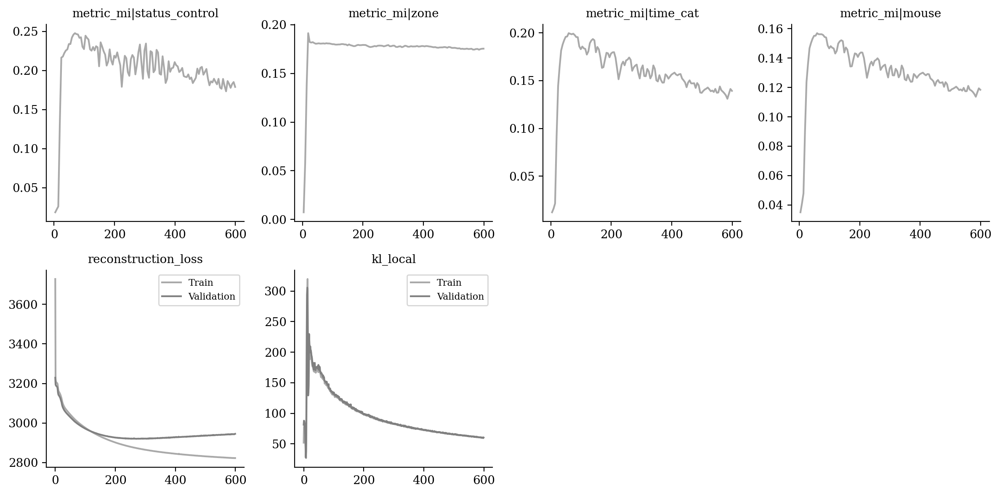

In [11]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [12]:
from tardis._disentanglementmanager import DisentanglementManager as DM

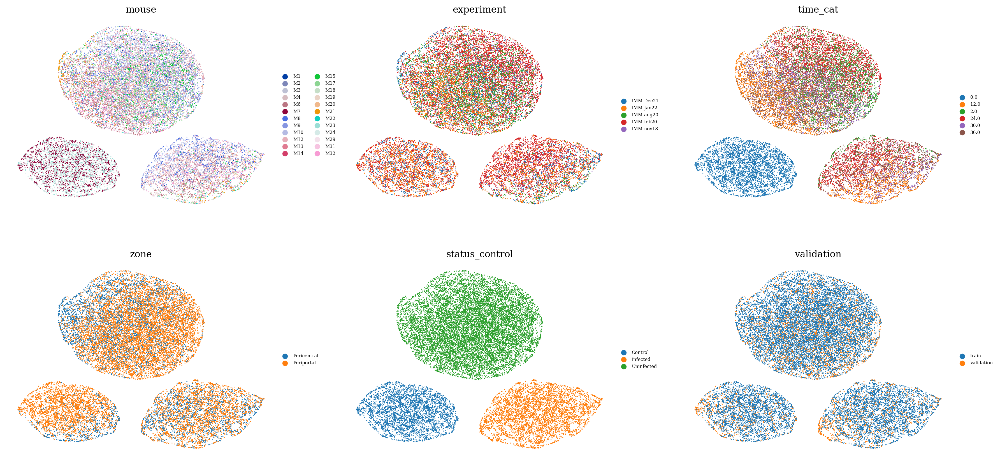

In [13]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

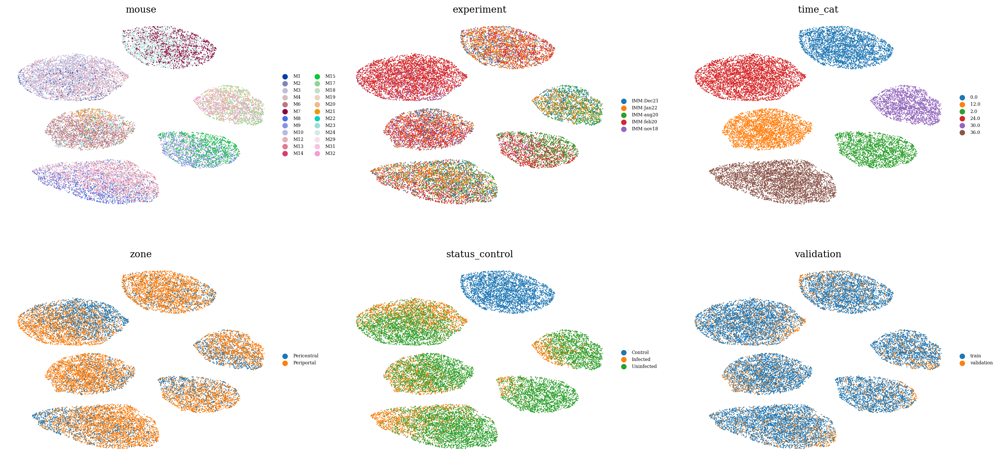

In [14]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

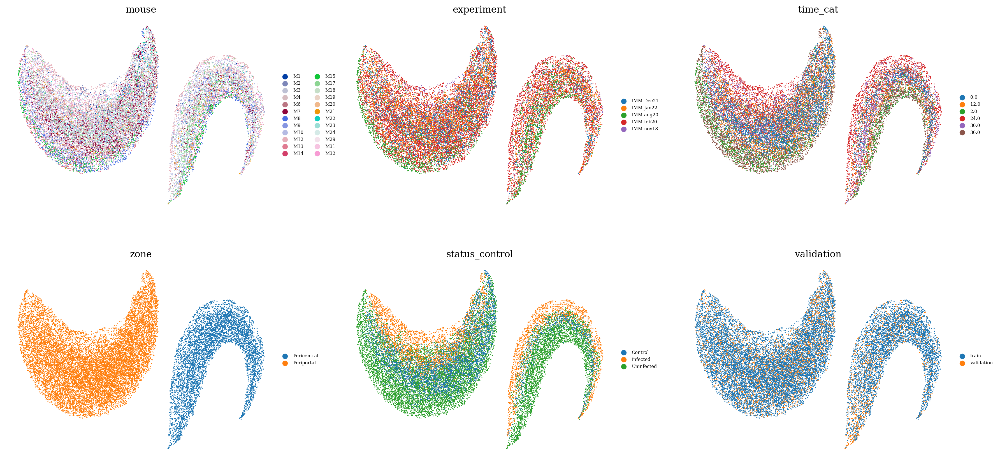

In [15]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

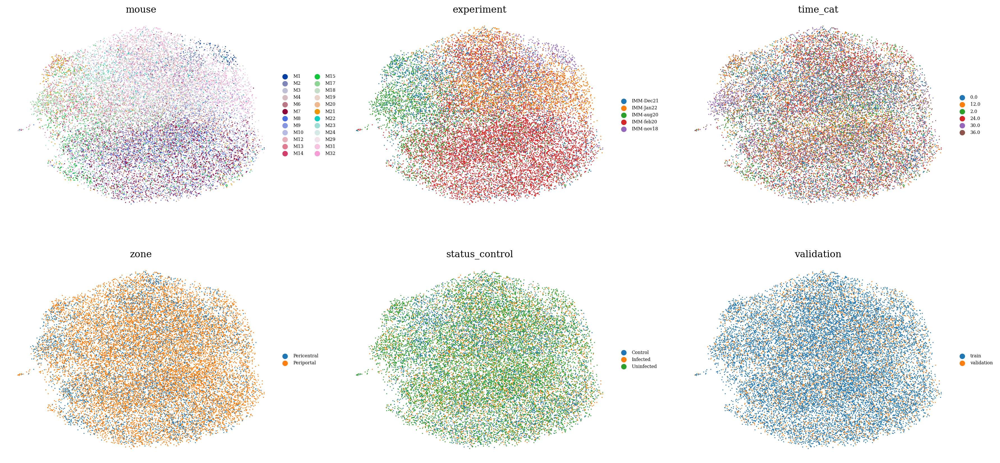

In [16]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

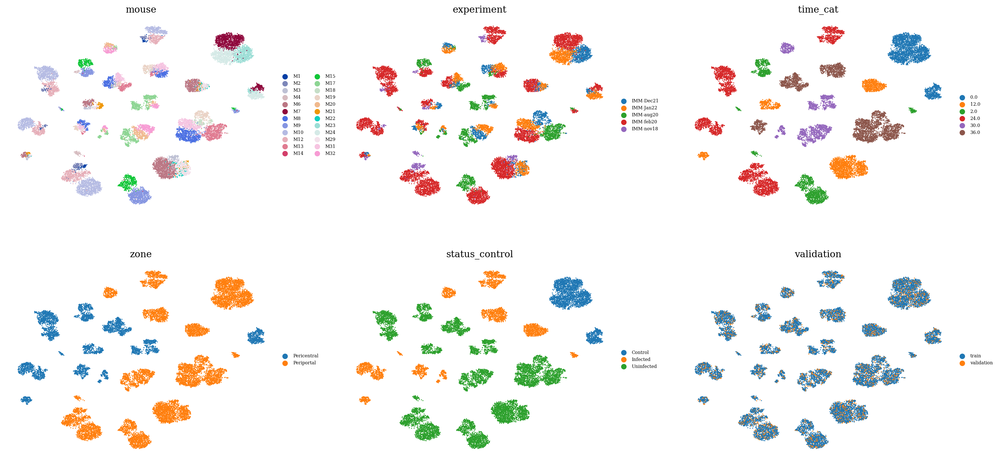

In [17]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )